<a href="https://colab.research.google.com/github/charm-113c/ai-lab-project/blob/main/V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import urllib.request
from random import randint
import random
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import copy
import numpy as np
import matplotlib.pyplot as plt


In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
# Miscellaneous parameters

batch_size = 128 # First tried 64 as in Pytorch doc
n_epochs = 125
image_size = 64
workers = 1 # for dataloader

# Decide which device (gpus or cpu) we want to run on
ngpu = 1 # number of gpus, 1 on Colab
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")


"""
With batch size of 128 (recommended in paper) it took 8 epochs for generator
to output something over than pure white (actually purple) noise.
Nvm it seems my code is wrong.
I take back everything, it outputted something neat.
Well, not that neat, but it's something that with batch_size = 64 would have
come at epoch 10 or something.
"""

"\nWith batch size of 128 (recommended in paper) it took 8 epochs for generator \nto output something over than pure white (actually purple) noise. \nNvm it seems my code is wrong. \nI take back everything, it outputted something neat right away.\nWell, not that neat, but it's something that with batch_size = 64 would have \ncome at epoch 10 or something.\n"

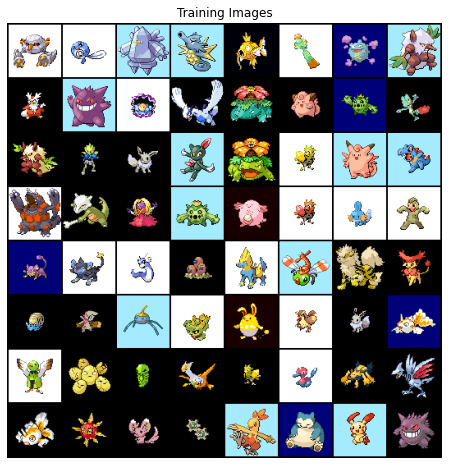

In [ ]:
# Loading and visualizing the data


# Root directory for dataset
dataroot = "/content/gdrive/My Drive/data/"


# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers,
                                         drop_last=True)

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
# Set random seed for reproducibility
manualSeed = 777
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print(device)

Random Seed:  777
cpu


In [ ]:
# Creating Generator and Discriminator (=Critic)

import torch
import torch.nn as nn

noise_dim = 100 # dimension of noise vector
num_ch = 3 # number of channels
n_gen_f = 64 # generator feature map size
n_disc_f = 64 # discriminator feature map size


#### Generator

class Generator(nn.Module):
    def __init__(self):
      super(Generator, self).__init__()
      self.main = nn.Sequential(
          # as in paper's code (4x4 kernel instead of 5x5), 64*16 = 1024 channel output
          nn.ConvTranspose2d(noise_dim, n_gen_f*8*2, 4, 1, 0, bias=False), # 4x4 imgs, ch = 1024
          nn.BatchNorm2d(n_gen_f*8*2),
          nn.ReLU(),

          nn.ConvTranspose2d(n_gen_f*8*2, n_gen_f*4*2, 4, 2, 1, bias=False), # 8x8 imgs, ch = 512
          nn.BatchNorm2d(n_gen_f*4*2), # *8
          nn.ReLU(),

          nn.ConvTranspose2d(n_gen_f*4*2, n_gen_f*2*2, 4, 2, 1, bias=False), # 16x16 imgs, ch = 216
          nn.BatchNorm2d(n_gen_f*2*2), # *4
          nn.ReLU(),

          nn.ConvTranspose2d(n_gen_f*2*2, n_gen_f*2, 4, 2, 1, bias=False), # 32x32 imgs, ch = 128
          nn.BatchNorm2d(n_gen_f*2), # *2
          nn.ReLU(),

          nn.ConvTranspose2d(n_gen_f*2, num_ch, 4, 2, 1, bias=False), # 64x64 imgs, ch = 3
          nn.Tanh(),
          # returns 64x64x3 image
      )

    def forward(self, input):
      return self.main(input)


#### Discriminator (Critic)

class Discriminator(nn.Module):
    def __init__(self):
      super(Discriminator, self).__init__()
      self.main = nn.Sequential(
          # Inverse structure to Generator
          # 64x64x3 img input
          nn.Conv2d(num_ch, n_disc_f*2, 4, 2, 1, bias=False),
          nn.LeakyReLU(0.2),

          nn.Conv2d(n_disc_f*2, n_disc_f*2*2, 4, 2, 1, bias=False),
          nn.BatchNorm2d(n_disc_f*2*2),
          nn.LeakyReLU(0.2),

          nn.Conv2d(n_disc_f*2*2, n_disc_f*4*2, 4, 2, 1, bias=False),
          nn.BatchNorm2d(n_disc_f*4*2),
          nn.LeakyReLU(0.2),

          nn.Conv2d(n_disc_f*4*2, n_disc_f*8*2, 4, 2, 1, bias=False),
          nn.BatchNorm2d(n_disc_f*8*2),
          nn.LeakyReLU(0.2),

          nn.Conv2d(n_disc_f*8*2, 1, 4, 1, 0, bias=False),
          nn.Sigmoid()
          # Returns scalar: evaluation of how real the input image is
        )

    def forward(self, input):
      return self.main(input)

"""
Note: initially, the generator's parameters had been set to be exactly that of
the paper's. That is, the number of output channels was double of what it
currently is (comments have been left as they were to showcase that).
Now setting discriminator to mirror the generator's architecture as output with
this generator wasn't bad.
"""


"\nNote: initially, the generator's parameters had been set to be exactly that of \nthe paper's. That is, the number of output channels was double of what it \ncurrently is (comments have been left as they were to showcase that). \nNow setting discriminator to mirror the generator's architecture as output with \nthis generator wasn't bad.\n"

In [ ]:
# Weight initialization function:

def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)
"""
Difference with Pytorch doc: batchNorm has different norm vals, mean = 1.0,
Where that comes from I don't know.
"""

# Model initialization

netG = Generator().to(device)
netD = Discriminator().to(device)

# Initializing weight following above normal distribution
netG.apply(initialize_weights)
netD.apply(initialize_weights)


Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2)
    (11): Conv2d(1024, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [ ]:
# Setting up for training

from torch.nn.modules.loss import BCELoss
import torch.optim as optim

# Hyperparams

lr = 0.0002 # Learning rate
lr_g = lr # lr of generator
lr_d = lr # lr of discriminator
beta1 = 0.5 # recommended Adam optimizer parameter
# beta2 is left to default .999
label_real = 0.9 # smoothed label for real images
label_fake = 0

# Create batch of latent vectors that we will use to visualize
# the progression of the generator
fixed_noise = torch.randn(64, noise_dim, 1, 1, device=device)

optG = optim.Adam(netG.parameters(),lr=lr_g,betas=(beta1,0.999))
optD = optim.Adam(netD.parameters(),lr=lr_g,betas=(beta1,0.999))

loss_func = BCELoss() # using BCE to compute loss


In [ ]:
black = torch.tensor(-1.)#.to(device) # Do not send to device.
# All tensors are normalized between -1 and 1, with -1 corresponding to black

def change_bg_to_black(imgs):
  """
  Given a set of 128 imgs of dim 3*64*64, sets the background colour to black.
  This function is imperfect, as it merely changes all colours == bg_colour
  to black, but it should work well enough (not too many issues).
  """
  for img in imgs:

    # each channel may have a different bg colour, we check them individually
    for channel in range(len(img)):
        bg_colour = img[channel,0,0] # 1st pixel always has same colour as bg
        if bg_colour != black:
          img[channel] = torch.where(img[channel] == black, img[channel], black)

  return imgs

Consider making a cup of coffee in the meantime
[1/125][0/29]	Loss_D: 1.3854	Loss_G: 0.6986	D(x): 0.4984	D(G(z)): 0.4982 / 0.4966
[1/125][5/29]	Loss_D: 1.3224	Loss_G: 0.7073	D(x): 0.5380	D(G(z)): 0.4969 / 0.4912
[1/125][10/29]	Loss_D: 1.2017	Loss_G: 0.7895	D(x): 0.5768	D(G(z)): 0.4619 / 0.4440
[1/125][15/29]	Loss_D: 1.0036	Loss_G: 0.9454	D(x): 0.6274	D(G(z)): 0.3838 / 0.3681
[1/125][20/29]	Loss_D: 0.8561	Loss_G: 1.0848	D(x): 0.6777	D(G(z)): 0.3235 / 0.3123
[1/125][25/29]	Loss_D: 0.7459	Loss_G: 1.2142	D(x): 0.7246	D(G(z)): 0.2776 / 0.2687


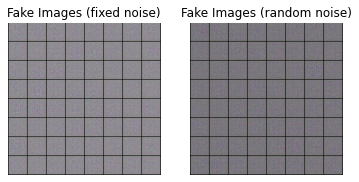

[2/125][0/29]	Loss_D: 0.6821	Loss_G: 1.3155	D(x): 0.7514	D(G(z)): 0.2470 / 0.2390
[2/125][5/29]	Loss_D: 0.6151	Loss_G: 1.4400	D(x): 0.7843	D(G(z)): 0.2141 / 0.2072
[2/125][10/29]	Loss_D: 0.5633	Loss_G: 1.5607	D(x): 0.8114	D(G(z)): 0.1866 / 0.1805
[2/125][15/29]	Loss_D: 0.5227	Loss_G: 1.6792	D(x): 0.8346	D(G(z)): 0.1632 / 0.1578
[2/125][20/29]	Loss_D: 0.4915	Loss_G: 1.7979	D(x): 0.8497	D(G(z)): 0.1428 / 0.1379
[2/125][25/29]	Loss_D: 0.4672	Loss_G: 1.9132	D(x): 0.8638	D(G(z)): 0.1257 / 0.1211


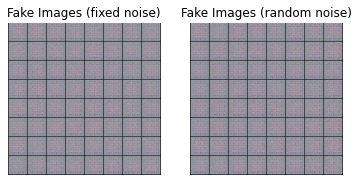

[3/125][0/29]	Loss_D: 0.4514	Loss_G: 1.9990	D(x): 0.8701	D(G(z)): 0.1135 / 0.1099
[3/125][5/29]	Loss_D: 0.4367	Loss_G: 2.0967	D(x): 0.8822	D(G(z)): 0.1031 / 0.0985
[3/125][10/29]	Loss_D: 0.4329	Loss_G: 2.1748	D(x): 0.8826	D(G(z)): 0.0980 / 0.0903
[3/125][15/29]	Loss_D: 0.4104	Loss_G: 2.3060	D(x): 0.8912	D(G(z)): 0.0801 / 0.0779
[3/125][20/29]	Loss_D: 0.4027	Loss_G: 2.4021	D(x): 0.8897	D(G(z)): 0.0717 / 0.0700
[3/125][25/29]	Loss_D: 0.3931	Loss_G: 2.4891	D(x): 0.8982	D(G(z)): 0.0651 / 0.0634


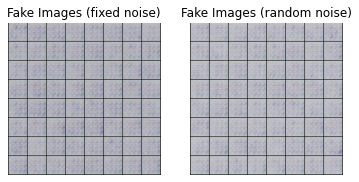

[4/125][0/29]	Loss_D: 0.3893	Loss_G: 2.5513	D(x): 0.9000	D(G(z)): 0.0614 / 0.0592
[4/125][5/29]	Loss_D: 0.3856	Loss_G: 2.6376	D(x): 0.8947	D(G(z)): 0.0558 / 0.0537
[4/125][10/29]	Loss_D: 0.3799	Loss_G: 2.7180	D(x): 0.8989	D(G(z)): 0.0512 / 0.0491
[4/125][15/29]	Loss_D: 0.3805	Loss_G: 2.7890	D(x): 0.8958	D(G(z)): 0.0493 / 0.0454
[4/125][20/29]	Loss_D: 0.3717	Loss_G: 2.8684	D(x): 0.8961	D(G(z)): 0.0443 / 0.0415
[4/125][25/29]	Loss_D: 0.3683	Loss_G: 2.9380	D(x): 0.8973	D(G(z)): 0.0402 / 0.0384


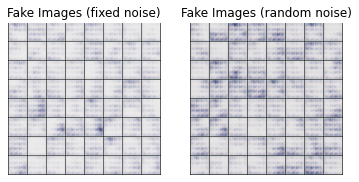

[5/125][0/29]	Loss_D: 0.3653	Loss_G: 2.9971	D(x): 0.8985	D(G(z)): 0.0385 / 0.0360
[5/125][5/29]	Loss_D: 0.3634	Loss_G: 3.0649	D(x): 0.8991	D(G(z)): 0.0350 / 0.0334
[5/125][10/29]	Loss_D: 0.3652	Loss_G: 3.1157	D(x): 0.8931	D(G(z)): 0.0337 / 0.0318
[5/125][15/29]	Loss_D: 0.3570	Loss_G: 3.2088	D(x): 0.8931	D(G(z)): 0.0298 / 0.0286
[5/125][20/29]	Loss_D: 0.3535	Loss_G: 3.2790	D(x): 0.8967	D(G(z)): 0.0274 / 0.0264
[5/125][25/29]	Loss_D: 0.3766	Loss_G: 3.2831	D(x): 0.8929	D(G(z)): 0.0401 / 0.0264


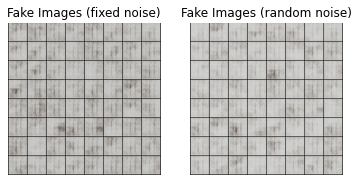

[6/125][0/29]	Loss_D: 0.3510	Loss_G: 3.4052	D(x): 0.9059	D(G(z)): 0.0235 / 0.0228
[6/125][5/29]	Loss_D: 0.3488	Loss_G: 3.4572	D(x): 0.9026	D(G(z)): 0.0222 / 0.0216
[6/125][10/29]	Loss_D: 0.3476	Loss_G: 3.4987	D(x): 0.9030	D(G(z)): 0.0214 / 0.0206
[6/125][15/29]	Loss_D: 0.3473	Loss_G: 3.5363	D(x): 0.9045	D(G(z)): 0.0211 / 0.0199
[6/125][20/29]	Loss_D: 0.3456	Loss_G: 3.5942	D(x): 0.8984	D(G(z)): 0.0196 / 0.0187
[6/125][25/29]	Loss_D: 0.3448	Loss_G: 3.6496	D(x): 0.8886	D(G(z)): 0.0182 / 0.0176


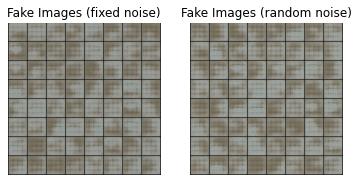

[7/125][0/29]	Loss_D: 0.3434	Loss_G: 3.6917	D(x): 0.8959	D(G(z)): 0.0175 / 0.0167
[7/125][5/29]	Loss_D: 0.3423	Loss_G: 3.7552	D(x): 0.8997	D(G(z)): 0.0165 / 0.0156
[7/125][10/29]	Loss_D: 0.3435	Loss_G: 3.7866	D(x): 0.8970	D(G(z)): 0.0165 / 0.0153
[7/125][15/29]	Loss_D: 0.3412	Loss_G: 3.8656	D(x): 0.9019	D(G(z)): 0.0151 / 0.0138
[7/125][20/29]	Loss_D: 0.3424	Loss_G: 3.8685	D(x): 0.9064	D(G(z)): 0.0149 / 0.0138
[7/125][25/29]	Loss_D: 0.3399	Loss_G: 3.9064	D(x): 0.8938	D(G(z)): 0.0141 / 0.0132


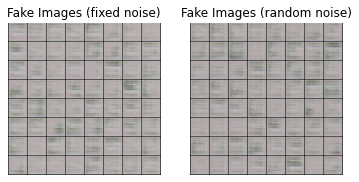

[8/125][0/29]	Loss_D: 0.3400	Loss_G: 3.9360	D(x): 0.9053	D(G(z)): 0.0142 / 0.0129
[8/125][5/29]	Loss_D: 0.3434	Loss_G: 3.9590	D(x): 0.8901	D(G(z)): 0.0146 / 0.0123
[8/125][10/29]	Loss_D: 0.3402	Loss_G: 4.0125	D(x): 0.8914	D(G(z)): 0.0126 / 0.0117
[8/125][15/29]	Loss_D: 0.3407	Loss_G: 4.0259	D(x): 0.8997	D(G(z)): 0.0125 / 0.0115
[8/125][20/29]	Loss_D: 0.3440	Loss_G: 3.9498	D(x): 0.8937	D(G(z)): 0.0134 / 0.0126
[8/125][25/29]	Loss_D: 0.7410	Loss_G: 0.5473	D(x): 0.5895	D(G(z)): 0.0110 / 0.6315


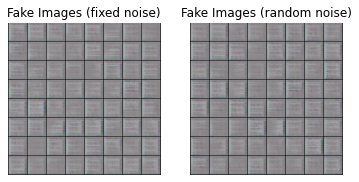

[9/125][0/29]	Loss_D: 0.6468	Loss_G: 2.3039	D(x): 0.7505	D(G(z)): 0.2095 / 0.0897
[9/125][5/29]	Loss_D: 0.4187	Loss_G: 3.5124	D(x): 0.8135	D(G(z)): 0.0532 / 0.0212
[9/125][10/29]	Loss_D: 0.4001	Loss_G: 3.6562	D(x): 0.8405	D(G(z)): 0.0498 / 0.0201
[9/125][15/29]	Loss_D: 0.3934	Loss_G: 3.7047	D(x): 0.8959	D(G(z)): 0.0576 / 0.0182
[9/125][20/29]	Loss_D: 0.8303	Loss_G: 2.9170	D(x): 0.4488	D(G(z)): 0.0238 / 0.0450
[9/125][25/29]	Loss_D: 0.4742	Loss_G: 4.2894	D(x): 0.7115	D(G(z)): 0.0113 / 0.0089


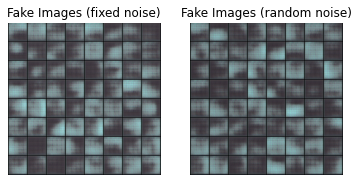

[10/125][0/29]	Loss_D: 0.3528	Loss_G: 3.7801	D(x): 0.9066	D(G(z)): 0.0211 / 0.0173
[10/125][5/29]	Loss_D: 0.3861	Loss_G: 3.7600	D(x): 0.8704	D(G(z)): 0.0432 / 0.0175
[10/125][10/29]	Loss_D: 0.3601	Loss_G: 3.8727	D(x): 0.8816	D(G(z)): 0.0244 / 0.0143
[10/125][15/29]	Loss_D: 0.3623	Loss_G: 4.0176	D(x): 0.8902	D(G(z)): 0.0271 / 0.0123
[10/125][20/29]	Loss_D: 0.3615	Loss_G: 4.0878	D(x): 0.8926	D(G(z)): 0.0290 / 0.0116
[10/125][25/29]	Loss_D: 0.3999	Loss_G: 3.7315	D(x): 0.8322	D(G(z)): 0.0350 / 0.0186


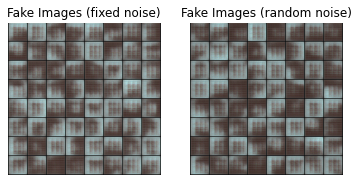

[11/125][0/29]	Loss_D: 0.3567	Loss_G: 3.9981	D(x): 0.8884	D(G(z)): 0.0205 / 0.0128
[11/125][5/29]	Loss_D: 0.3617	Loss_G: 4.0253	D(x): 0.9000	D(G(z)): 0.0258 / 0.0119
[11/125][10/29]	Loss_D: 0.3555	Loss_G: 4.0564	D(x): 0.8768	D(G(z)): 0.0189 / 0.0118
[11/125][15/29]	Loss_D: 0.3462	Loss_G: 4.1981	D(x): 0.8974	D(G(z)): 0.0153 / 0.0101
[11/125][20/29]	Loss_D: 0.3480	Loss_G: 4.1095	D(x): 0.8740	D(G(z)): 0.0129 / 0.0113
[11/125][25/29]	Loss_D: 0.3448	Loss_G: 4.2444	D(x): 0.8795	D(G(z)): 0.0139 / 0.0100


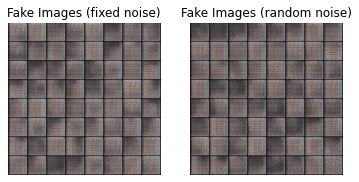

[12/125][0/29]	Loss_D: 0.3623	Loss_G: 4.2308	D(x): 0.8546	D(G(z)): 0.0202 / 0.0113
[12/125][5/29]	Loss_D: 0.3594	Loss_G: 4.0698	D(x): 0.9045	D(G(z)): 0.0192 / 0.0113
[12/125][10/29]	Loss_D: 0.3544	Loss_G: 3.8974	D(x): 0.8734	D(G(z)): 0.0200 / 0.0138
[12/125][15/29]	Loss_D: 0.3509	Loss_G: 4.1072	D(x): 0.8614	D(G(z)): 0.0130 / 0.0109
[12/125][20/29]	Loss_D: 0.3448	Loss_G: 4.2403	D(x): 0.9121	D(G(z)): 0.0150 / 0.0095
[12/125][25/29]	Loss_D: 0.3422	Loss_G: 4.3360	D(x): 0.8983	D(G(z)): 0.0123 / 0.0085


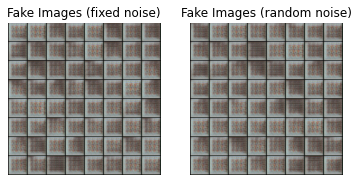

[13/125][0/29]	Loss_D: 0.3472	Loss_G: 4.0152	D(x): 0.8630	D(G(z)): 0.0086 / 0.0130
[13/125][5/29]	Loss_D: 0.3414	Loss_G: 4.6483	D(x): 0.9127	D(G(z)): 0.0124 / 0.0060
[13/125][10/29]	Loss_D: 1.1019	Loss_G: 0.4012	D(x): 0.5342	D(G(z)): 0.0945 / 0.7961
[13/125][15/29]	Loss_D: 0.5197	Loss_G: 2.6309	D(x): 0.7157	D(G(z)): 0.0839 / 0.0634
[13/125][20/29]	Loss_D: 0.4108	Loss_G: 3.4200	D(x): 0.8450	D(G(z)): 0.0624 / 0.0273
[13/125][25/29]	Loss_D: 0.5042	Loss_G: 4.0601	D(x): 0.8529	D(G(z)): 0.1411 / 0.0122


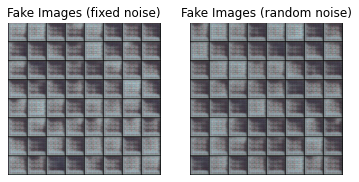

[14/125][0/29]	Loss_D: 0.8861	Loss_G: 1.5302	D(x): 0.5800	D(G(z)): 0.2424 / 0.2182
[14/125][5/29]	Loss_D: 0.6027	Loss_G: 3.0809	D(x): 0.8181	D(G(z)): 0.2021 / 0.0399
[14/125][10/29]	Loss_D: 1.4221	Loss_G: 1.9022	D(x): 0.2682	D(G(z)): 0.0397 / 0.1422
[14/125][15/29]	Loss_D: 0.5580	Loss_G: 2.8022	D(x): 0.7906	D(G(z)): 0.1500 / 0.0566
[14/125][20/29]	Loss_D: 0.8429	Loss_G: 3.8367	D(x): 0.8420	D(G(z)): 0.3440 / 0.0160
[14/125][25/29]	Loss_D: 0.4624	Loss_G: 3.4399	D(x): 0.7723	D(G(z)): 0.0545 / 0.0240


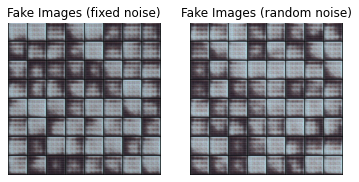

[15/125][0/29]	Loss_D: 1.0761	Loss_G: 2.2970	D(x): 0.4295	D(G(z)): 0.0188 / 0.1644
[15/125][5/29]	Loss_D: 0.6808	Loss_G: 4.5461	D(x): 0.8481	D(G(z)): 0.2480 / 0.0088
[15/125][10/29]	Loss_D: 0.5715	Loss_G: 4.1664	D(x): 0.8500	D(G(z)): 0.1925 / 0.0116
[15/125][15/29]	Loss_D: 0.5530	Loss_G: 2.7002	D(x): 0.6785	D(G(z)): 0.0430 / 0.0740
[15/125][20/29]	Loss_D: 0.4832	Loss_G: 3.6103	D(x): 0.8202	D(G(z)): 0.0824 / 0.0222
[15/125][25/29]	Loss_D: 1.2673	Loss_G: 4.1582	D(x): 0.9249	D(G(z)): 0.5541 / 0.0110


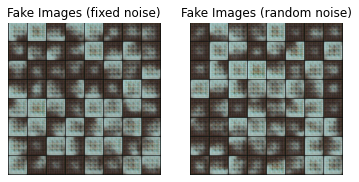

[16/125][0/29]	Loss_D: 0.5588	Loss_G: 3.1700	D(x): 0.6698	D(G(z)): 0.0666 / 0.0393
[16/125][5/29]	Loss_D: 0.8274	Loss_G: 2.6504	D(x): 0.4966	D(G(z)): 0.0734 / 0.0738
[16/125][10/29]	Loss_D: 0.4731	Loss_G: 3.1782	D(x): 0.7910	D(G(z)): 0.0697 / 0.0397
[16/125][15/29]	Loss_D: 0.9323	Loss_G: 3.8516	D(x): 0.9036	D(G(z)): 0.4094 / 0.0194
[16/125][20/29]	Loss_D: 0.5076	Loss_G: 3.5158	D(x): 0.8119	D(G(z)): 0.1137 / 0.0218
[16/125][25/29]	Loss_D: 0.6374	Loss_G: 1.8180	D(x): 0.6200	D(G(z)): 0.0757 / 0.1653


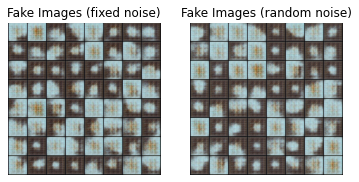

[17/125][0/29]	Loss_D: 0.6655	Loss_G: 3.6025	D(x): 0.9219	D(G(z)): 0.2613 / 0.0210
[17/125][5/29]	Loss_D: 0.4926	Loss_G: 2.7850	D(x): 0.7380	D(G(z)): 0.0511 / 0.0527
[17/125][10/29]	Loss_D: 0.4338	Loss_G: 3.4418	D(x): 0.8595	D(G(z)): 0.0827 / 0.0233
[17/125][15/29]	Loss_D: 0.5096	Loss_G: 3.9267	D(x): 0.8511	D(G(z)): 0.1337 / 0.0152
[17/125][20/29]	Loss_D: 0.5324	Loss_G: 3.1167	D(x): 0.8084	D(G(z)): 0.1293 / 0.0403
[17/125][25/29]	Loss_D: 0.4340	Loss_G: 3.8055	D(x): 0.8761	D(G(z)): 0.0890 / 0.0161


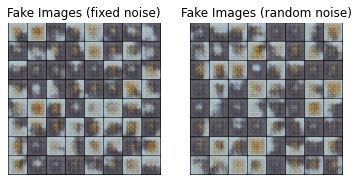

[18/125][0/29]	Loss_D: 0.5658	Loss_G: 5.0042	D(x): 0.9033	D(G(z)): 0.1984 / 0.0045
[18/125][5/29]	Loss_D: 0.4835	Loss_G: 2.6860	D(x): 0.8462	D(G(z)): 0.1205 / 0.0620
[18/125][10/29]	Loss_D: 0.4399	Loss_G: 3.3761	D(x): 0.8345	D(G(z)): 0.0789 / 0.0263
[18/125][15/29]	Loss_D: 0.4419	Loss_G: 3.7090	D(x): 0.8432	D(G(z)): 0.0824 / 0.0179
[18/125][20/29]	Loss_D: 2.4866	Loss_G: 0.7429	D(x): 0.0958	D(G(z)): 0.0151 / 0.4786
[18/125][25/29]	Loss_D: 0.4420	Loss_G: 2.6772	D(x): 0.8057	D(G(z)): 0.0638 / 0.0554


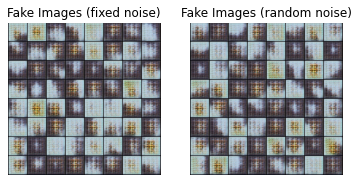

[19/125][0/29]	Loss_D: 0.5544	Loss_G: 3.4375	D(x): 0.8185	D(G(z)): 0.1701 / 0.0231
[19/125][5/29]	Loss_D: 1.0124	Loss_G: 1.5209	D(x): 0.4449	D(G(z)): 0.0250 / 0.2582
[19/125][10/29]	Loss_D: 0.4851	Loss_G: 3.3246	D(x): 0.7714	D(G(z)): 0.0820 / 0.0284
[19/125][15/29]	Loss_D: 0.5159	Loss_G: 3.9722	D(x): 0.8687	D(G(z)): 0.1431 / 0.0162
[19/125][20/29]	Loss_D: 0.4632	Loss_G: 3.1128	D(x): 0.8680	D(G(z)): 0.1011 / 0.0368
[19/125][25/29]	Loss_D: 0.3969	Loss_G: 3.7639	D(x): 0.8349	D(G(z)): 0.0346 / 0.0170


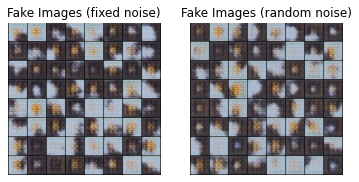

[20/125][0/29]	Loss_D: 0.4335	Loss_G: 3.1325	D(x): 0.7951	D(G(z)): 0.0436 / 0.0370
[20/125][5/29]	Loss_D: 0.3965	Loss_G: 3.6425	D(x): 0.8712	D(G(z)): 0.0484 / 0.0194
[20/125][10/29]	Loss_D: 0.5830	Loss_G: 1.9283	D(x): 0.7049	D(G(z)): 0.0685 / 0.3034
[20/125][15/29]	Loss_D: 1.6374	Loss_G: 2.0923	D(x): 0.9406	D(G(z)): 0.6891 / 0.1226
[20/125][20/29]	Loss_D: 0.7928	Loss_G: 1.6717	D(x): 0.5262	D(G(z)): 0.0740 / 0.1966
[20/125][25/29]	Loss_D: 1.1514	Loss_G: 2.5726	D(x): 0.7656	D(G(z)): 0.4756 / 0.0674


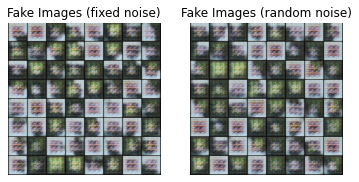

[21/125][0/29]	Loss_D: 0.7588	Loss_G: 1.1686	D(x): 0.5069	D(G(z)): 0.0413 / 0.2964
[21/125][5/29]	Loss_D: 0.4858	Loss_G: 3.2035	D(x): 0.7445	D(G(z)): 0.0670 / 0.0309
[21/125][10/29]	Loss_D: 0.8665	Loss_G: 3.0249	D(x): 0.4276	D(G(z)): 0.0076 / 0.0628
[21/125][15/29]	Loss_D: 0.4513	Loss_G: 3.8689	D(x): 0.8494	D(G(z)): 0.0988 / 0.0149
[21/125][20/29]	Loss_D: 1.5614	Loss_G: 4.8520	D(x): 0.9199	D(G(z)): 0.6639 / 0.0055
[21/125][25/29]	Loss_D: 0.7032	Loss_G: 2.8731	D(x): 0.8402	D(G(z)): 0.2924 / 0.0455


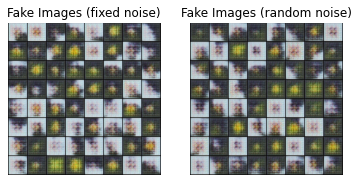

[22/125][0/29]	Loss_D: 0.5503	Loss_G: 2.9753	D(x): 0.7726	D(G(z)): 0.1393 / 0.0426
[22/125][5/29]	Loss_D: 0.7498	Loss_G: 1.0344	D(x): 0.5198	D(G(z)): 0.0287 / 0.3628
[22/125][10/29]	Loss_D: 0.7158	Loss_G: 2.2208	D(x): 0.5387	D(G(z)): 0.0252 / 0.1337
[22/125][15/29]	Loss_D: 0.6869	Loss_G: 2.3169	D(x): 0.6408	D(G(z)): 0.1474 / 0.0799
[22/125][20/29]	Loss_D: 0.4305	Loss_G: 3.4796	D(x): 0.8060	D(G(z)): 0.0507 / 0.0229
[22/125][25/29]	Loss_D: 0.6153	Loss_G: 3.2710	D(x): 0.8916	D(G(z)): 0.2377 / 0.0296


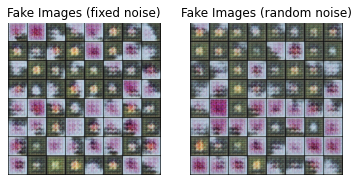

[23/125][0/29]	Loss_D: 0.7306	Loss_G: 2.4372	D(x): 0.8932	D(G(z)): 0.3026 / 0.0744
[23/125][5/29]	Loss_D: 0.4751	Loss_G: 3.1371	D(x): 0.7686	D(G(z)): 0.0671 / 0.0360
[23/125][10/29]	Loss_D: 0.4449	Loss_G: 3.1433	D(x): 0.7923	D(G(z)): 0.0537 / 0.0339
[23/125][15/29]	Loss_D: 0.7335	Loss_G: 2.5335	D(x): 0.5128	D(G(z)): 0.0158 / 0.0711
[23/125][20/29]	Loss_D: 0.4138	Loss_G: 3.1080	D(x): 0.8780	D(G(z)): 0.0637 / 0.0349
[23/125][25/29]	Loss_D: 0.6526	Loss_G: 4.0733	D(x): 0.8845	D(G(z)): 0.2353 / 0.0148


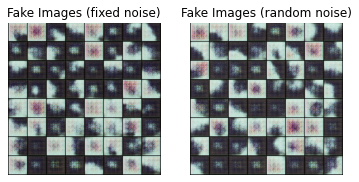

[24/125][0/29]	Loss_D: 0.6312	Loss_G: 4.0929	D(x): 0.9392	D(G(z)): 0.2401 / 0.0145
[24/125][5/29]	Loss_D: 0.4555	Loss_G: 3.2602	D(x): 0.8941	D(G(z)): 0.1016 / 0.0298
[24/125][10/29]	Loss_D: 0.8323	Loss_G: 5.2196	D(x): 0.9195	D(G(z)): 0.3757 / 0.0032
[24/125][15/29]	Loss_D: 0.6882	Loss_G: 2.7452	D(x): 0.7702	D(G(z)): 0.2442 / 0.0537
[24/125][20/29]	Loss_D: 0.6389	Loss_G: 2.6696	D(x): 0.8589	D(G(z)): 0.2520 / 0.0602
[24/125][25/29]	Loss_D: 0.7348	Loss_G: 3.6401	D(x): 0.8089	D(G(z)): 0.3011 / 0.0188


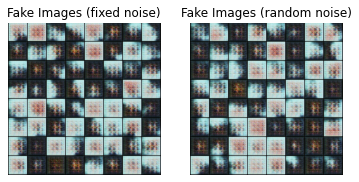

[25/125][0/29]	Loss_D: 0.5814	Loss_G: 2.5172	D(x): 0.8288	D(G(z)): 0.1568 / 0.0661
[25/125][5/29]	Loss_D: 0.9378	Loss_G: 2.9028	D(x): 0.9389	D(G(z)): 0.4106 / 0.0449
[25/125][10/29]	Loss_D: 0.5151	Loss_G: 2.5473	D(x): 0.7380	D(G(z)): 0.0757 / 0.0645
[25/125][15/29]	Loss_D: 0.8437	Loss_G: 3.9647	D(x): 0.8673	D(G(z)): 0.3464 / 0.0142
[25/125][20/29]	Loss_D: 0.8170	Loss_G: 2.1855	D(x): 0.8024	D(G(z)): 0.3445 / 0.0977
[25/125][25/29]	Loss_D: 0.4401	Loss_G: 2.8524	D(x): 0.7888	D(G(z)): 0.0475 / 0.0445


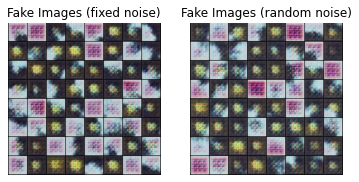

[26/125][0/29]	Loss_D: 0.5072	Loss_G: 3.3293	D(x): 0.8339	D(G(z)): 0.1351 / 0.0272
[26/125][5/29]	Loss_D: 1.6254	Loss_G: 1.4235	D(x): 0.1934	D(G(z)): 0.0073 / 0.3037
[26/125][10/29]	Loss_D: 1.1642	Loss_G: 1.5930	D(x): 0.4414	D(G(z)): 0.2885 / 0.1869
[26/125][15/29]	Loss_D: 0.6438	Loss_G: 2.1488	D(x): 0.6837	D(G(z)): 0.1575 / 0.1017
[26/125][20/29]	Loss_D: 0.6456	Loss_G: 3.7647	D(x): 0.8085	D(G(z)): 0.2323 / 0.0189
[26/125][25/29]	Loss_D: 0.7638	Loss_G: 2.5337	D(x): 0.7453	D(G(z)): 0.2843 / 0.0650


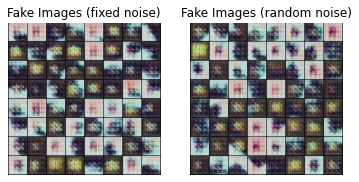

[27/125][0/29]	Loss_D: 0.5018	Loss_G: 3.0935	D(x): 0.8058	D(G(z)): 0.1173 / 0.0346
[27/125][5/29]	Loss_D: 0.5921	Loss_G: 2.8543	D(x): 0.8199	D(G(z)): 0.1959 / 0.0485
[27/125][10/29]	Loss_D: 0.5353	Loss_G: 3.2775	D(x): 0.8076	D(G(z)): 0.1462 / 0.0278
[27/125][15/29]	Loss_D: 1.8026	Loss_G: 1.9566	D(x): 0.1616	D(G(z)): 0.0098 / 0.1428
[27/125][20/29]	Loss_D: 1.0522	Loss_G: 1.3945	D(x): 0.5180	D(G(z)): 0.2152 / 0.2737
[27/125][25/29]	Loss_D: 0.6334	Loss_G: 2.5066	D(x): 0.7963	D(G(z)): 0.2172 / 0.0716


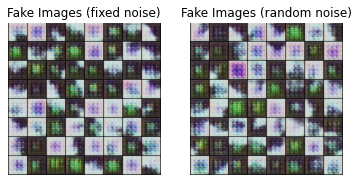

[28/125][0/29]	Loss_D: 0.6543	Loss_G: 2.0489	D(x): 0.6225	D(G(z)): 0.1030 / 0.1104
[28/125][5/29]	Loss_D: 1.0118	Loss_G: 1.1589	D(x): 0.3966	D(G(z)): 0.0652 / 0.3064
[28/125][10/29]	Loss_D: 0.7047	Loss_G: 3.7738	D(x): 0.8491	D(G(z)): 0.2787 / 0.0174
[28/125][15/29]	Loss_D: 0.5908	Loss_G: 2.9588	D(x): 0.7737	D(G(z)): 0.1777 / 0.0414
[28/125][20/29]	Loss_D: 0.5542	Loss_G: 3.6889	D(x): 0.8038	D(G(z)): 0.1468 / 0.0185
[28/125][25/29]	Loss_D: 0.5761	Loss_G: 3.3406	D(x): 0.7012	D(G(z)): 0.0877 / 0.0352


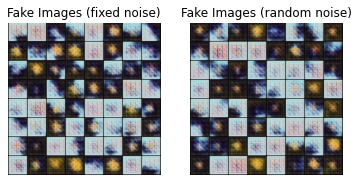

[29/125][0/29]	Loss_D: 0.6322	Loss_G: 2.2602	D(x): 0.7043	D(G(z)): 0.1484 / 0.0986
[29/125][5/29]	Loss_D: 1.1754	Loss_G: 3.9699	D(x): 0.9248	D(G(z)): 0.5392 / 0.0138
[29/125][10/29]	Loss_D: 0.5111	Loss_G: 2.7024	D(x): 0.7566	D(G(z)): 0.0886 / 0.0539
[29/125][15/29]	Loss_D: 0.5953	Loss_G: 3.9817	D(x): 0.8401	D(G(z)): 0.2079 / 0.0129
[29/125][20/29]	Loss_D: 1.2633	Loss_G: 0.9276	D(x): 0.2861	D(G(z)): 0.0228 / 0.3980
[29/125][25/29]	Loss_D: 0.5088	Loss_G: 2.8858	D(x): 0.8467	D(G(z)): 0.1448 / 0.0458


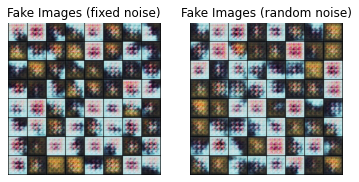

[30/125][0/29]	Loss_D: 0.4924	Loss_G: 2.9291	D(x): 0.8055	D(G(z)): 0.1103 / 0.0427
[30/125][5/29]	Loss_D: 0.6868	Loss_G: 4.3785	D(x): 0.8537	D(G(z)): 0.2709 / 0.0090
[30/125][10/29]	Loss_D: 0.4779	Loss_G: 2.7389	D(x): 0.7484	D(G(z)): 0.0609 / 0.0529
[30/125][15/29]	Loss_D: 0.5079	Loss_G: 3.2066	D(x): 0.7748	D(G(z)): 0.0980 / 0.0324
[30/125][20/29]	Loss_D: 2.2091	Loss_G: 1.8057	D(x): 0.1348	D(G(z)): 0.0058 / 0.1669
[30/125][25/29]	Loss_D: 0.5464	Loss_G: 2.6676	D(x): 0.7233	D(G(z)): 0.1029 / 0.0614


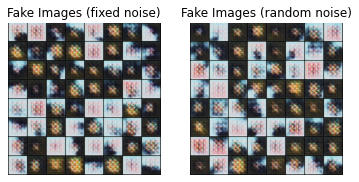

[31/125][0/29]	Loss_D: 0.8629	Loss_G: 4.3522	D(x): 0.8837	D(G(z)): 0.3918 / 0.0093
[31/125][5/29]	Loss_D: 0.5356	Loss_G: 3.5556	D(x): 0.8438	D(G(z)): 0.1677 / 0.0203
[31/125][10/29]	Loss_D: 0.5637	Loss_G: 2.6105	D(x): 0.7133	D(G(z)): 0.1131 / 0.0587
[31/125][15/29]	Loss_D: 0.5350	Loss_G: 3.1313	D(x): 0.7792	D(G(z)): 0.1309 / 0.0343
[31/125][20/29]	Loss_D: 2.1670	Loss_G: 3.5942	D(x): 0.9634	D(G(z)): 0.7663 / 0.0492
[31/125][25/29]	Loss_D: 0.5731	Loss_G: 2.2638	D(x): 0.7155	D(G(z)): 0.1278 / 0.0869


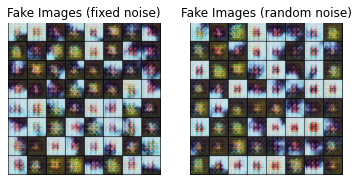

[32/125][0/29]	Loss_D: 0.9802	Loss_G: 0.5634	D(x): 0.3936	D(G(z)): 0.0147 / 0.6587
[32/125][5/29]	Loss_D: 0.5367	Loss_G: 2.9487	D(x): 0.7547	D(G(z)): 0.1188 / 0.0422
[32/125][10/29]	Loss_D: 0.5900	Loss_G: 2.6429	D(x): 0.7306	D(G(z)): 0.1414 / 0.0572
[32/125][15/29]	Loss_D: 0.6899	Loss_G: 4.2122	D(x): 0.8997	D(G(z)): 0.2941 / 0.0104
[32/125][20/29]	Loss_D: 0.4156	Loss_G: 3.8471	D(x): 0.8598	D(G(z)): 0.0679 / 0.0160
[32/125][25/29]	Loss_D: 0.5052	Loss_G: 3.0048	D(x): 0.7810	D(G(z)): 0.1006 / 0.0414


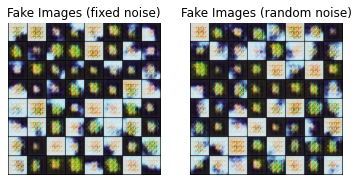

[33/125][0/29]	Loss_D: 2.3054	Loss_G: 0.9164	D(x): 0.1186	D(G(z)): 0.0032 / 0.4618
[33/125][5/29]	Loss_D: 0.6515	Loss_G: 2.3247	D(x): 0.5929	D(G(z)): 0.0659 / 0.0806
[33/125][10/29]	Loss_D: 0.5592	Loss_G: 3.1663	D(x): 0.8540	D(G(z)): 0.1876 / 0.0315
[33/125][15/29]	Loss_D: 0.4957	Loss_G: 2.9848	D(x): 0.7069	D(G(z)): 0.0406 / 0.0398
[33/125][20/29]	Loss_D: 0.6711	Loss_G: 2.3941	D(x): 0.6636	D(G(z)): 0.1574 / 0.0767
[33/125][25/29]	Loss_D: 0.4793	Loss_G: 2.9471	D(x): 0.7766	D(G(z)): 0.0804 / 0.0448


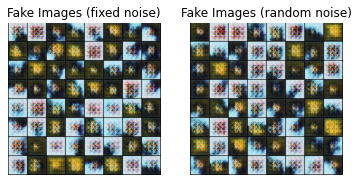

[34/125][0/29]	Loss_D: 0.5520	Loss_G: 2.3046	D(x): 0.7225	D(G(z)): 0.1002 / 0.0913
[34/125][5/29]	Loss_D: 0.8169	Loss_G: 2.9142	D(x): 0.9004	D(G(z)): 0.3657 / 0.0460
[34/125][10/29]	Loss_D: 0.7384	Loss_G: 3.7092	D(x): 0.7479	D(G(z)): 0.2746 / 0.0178
[34/125][15/29]	Loss_D: 0.9454	Loss_G: 2.7519	D(x): 0.4836	D(G(z)): 0.0166 / 0.0593
[34/125][20/29]	Loss_D: 0.6869	Loss_G: 2.0353	D(x): 0.6409	D(G(z)): 0.1483 / 0.1225
[34/125][25/29]	Loss_D: 0.4872	Loss_G: 3.1906	D(x): 0.7920	D(G(z)): 0.1019 / 0.0316


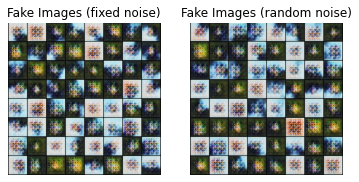

[35/125][0/29]	Loss_D: 0.5069	Loss_G: 3.8145	D(x): 0.8300	D(G(z)): 0.1368 / 0.0160
[35/125][5/29]	Loss_D: 1.0532	Loss_G: 1.2856	D(x): 0.3864	D(G(z)): 0.0691 / 0.3006
[35/125][10/29]	Loss_D: 0.6319	Loss_G: 2.4907	D(x): 0.6989	D(G(z)): 0.1449 / 0.0797
[35/125][15/29]	Loss_D: 0.8612	Loss_G: 1.9728	D(x): 0.4472	D(G(z)): 0.0256 / 0.1237
[35/125][20/29]	Loss_D: 0.5188	Loss_G: 2.9622	D(x): 0.8269	D(G(z)): 0.1468 / 0.0407
[35/125][25/29]	Loss_D: 0.5845	Loss_G: 3.1352	D(x): 0.7155	D(G(z)): 0.1207 / 0.0353


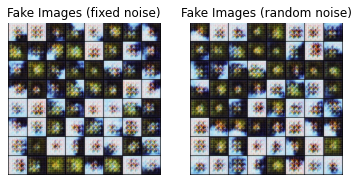

[36/125][0/29]	Loss_D: 0.5690	Loss_G: 3.3409	D(x): 0.7771	D(G(z)): 0.1618 / 0.0277
[36/125][5/29]	Loss_D: 0.6673	Loss_G: 3.8851	D(x): 0.8648	D(G(z)): 0.2650 / 0.0156
[36/125][10/29]	Loss_D: 0.6772	Loss_G: 2.4736	D(x): 0.6505	D(G(z)): 0.1410 / 0.0899
[36/125][15/29]	Loss_D: 0.5393	Loss_G: 2.4880	D(x): 0.7745	D(G(z)): 0.1197 / 0.0721
[36/125][20/29]	Loss_D: 0.4807	Loss_G: 2.5584	D(x): 0.7655	D(G(z)): 0.0762 / 0.0646
[36/125][25/29]	Loss_D: 1.6491	Loss_G: 1.7207	D(x): 0.2804	D(G(z)): 0.0062 / 0.2638


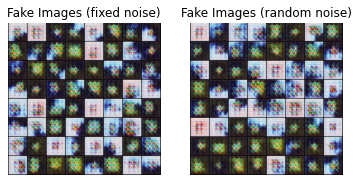

[37/125][0/29]	Loss_D: 0.5662	Loss_G: 2.4843	D(x): 0.7804	D(G(z)): 0.1561 / 0.0697
[37/125][5/29]	Loss_D: 0.5734	Loss_G: 2.1490	D(x): 0.6967	D(G(z)): 0.1011 / 0.1016
[37/125][10/29]	Loss_D: 0.5048	Loss_G: 2.6148	D(x): 0.7044	D(G(z)): 0.0431 / 0.0597
[37/125][15/29]	Loss_D: 1.6766	Loss_G: 4.9443	D(x): 0.9597	D(G(z)): 0.7036 / 0.0049
[37/125][20/29]	Loss_D: 0.4957	Loss_G: 2.6438	D(x): 0.7711	D(G(z)): 0.0945 / 0.0596
[37/125][25/29]	Loss_D: 1.1458	Loss_G: 6.0717	D(x): 0.9132	D(G(z)): 0.5250 / 0.0024


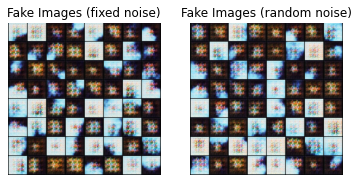

[38/125][0/29]	Loss_D: 0.6251	Loss_G: 2.3901	D(x): 0.6017	D(G(z)): 0.0587 / 0.0760
[38/125][5/29]	Loss_D: 0.5689	Loss_G: 3.3277	D(x): 0.7405	D(G(z)): 0.1332 / 0.0276
[38/125][10/29]	Loss_D: 0.8673	Loss_G: 1.3407	D(x): 0.4340	D(G(z)): 0.0197 / 0.2906
[38/125][15/29]	Loss_D: 0.5957	Loss_G: 3.0174	D(x): 0.7031	D(G(z)): 0.1161 / 0.0394
[38/125][20/29]	Loss_D: 0.6238	Loss_G: 3.6161	D(x): 0.7366	D(G(z)): 0.1779 / 0.0229
[38/125][25/29]	Loss_D: 0.4922	Loss_G: 3.1677	D(x): 0.7388	D(G(z)): 0.0673 / 0.0365


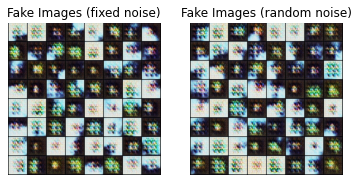

[39/125][0/29]	Loss_D: 0.6070	Loss_G: 3.6805	D(x): 0.8762	D(G(z)): 0.2283 / 0.0190
[39/125][5/29]	Loss_D: 0.4502	Loss_G: 3.4096	D(x): 0.8517	D(G(z)): 0.0930 / 0.0252
[39/125][10/29]	Loss_D: 1.1841	Loss_G: 6.3213	D(x): 0.9459	D(G(z)): 0.5464 / 0.0013
[39/125][15/29]	Loss_D: 0.6187	Loss_G: 2.8312	D(x): 0.6726	D(G(z)): 0.0714 / 0.0474
[39/125][20/29]	Loss_D: 0.6426	Loss_G: 2.8501	D(x): 0.6926	D(G(z)): 0.1595 / 0.0478
[39/125][25/29]	Loss_D: 0.6161	Loss_G: 2.4816	D(x): 0.7788	D(G(z)): 0.1747 / 0.0775


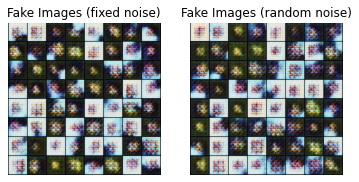

[40/125][0/29]	Loss_D: 0.5387	Loss_G: 3.2943	D(x): 0.7740	D(G(z)): 0.1296 / 0.0289
[40/125][5/29]	Loss_D: 0.7052	Loss_G: 1.2792	D(x): 0.5500	D(G(z)): 0.0523 / 0.2826
[40/125][10/29]	Loss_D: 0.4376	Loss_G: 3.5814	D(x): 0.8598	D(G(z)): 0.0881 / 0.0203
[40/125][15/29]	Loss_D: 0.5464	Loss_G: 3.1710	D(x): 0.7702	D(G(z)): 0.1262 / 0.0386
[40/125][20/29]	Loss_D: 0.4283	Loss_G: 3.6266	D(x): 0.8495	D(G(z)): 0.0790 / 0.0209
[40/125][25/29]	Loss_D: 0.5531	Loss_G: 3.8694	D(x): 0.8633	D(G(z)): 0.1825 / 0.0152


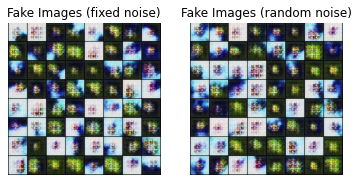

[41/125][0/29]	Loss_D: 0.8201	Loss_G: 2.2578	D(x): 0.8993	D(G(z)): 0.3630 / 0.0982
[41/125][5/29]	Loss_D: 0.5546	Loss_G: 2.6371	D(x): 0.7234	D(G(z)): 0.1078 / 0.0644
[41/125][10/29]	Loss_D: 0.5179	Loss_G: 3.4455	D(x): 0.8599	D(G(z)): 0.1535 / 0.0258
[41/125][15/29]	Loss_D: 0.5257	Loss_G: 3.4962	D(x): 0.8545	D(G(z)): 0.1609 / 0.0229
[41/125][20/29]	Loss_D: 0.4716	Loss_G: 3.0920	D(x): 0.8284	D(G(z)): 0.1022 / 0.0397
[41/125][25/29]	Loss_D: 0.4339	Loss_G: 3.3923	D(x): 0.7948	D(G(z)): 0.0473 / 0.0333


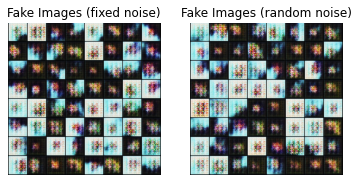

[42/125][0/29]	Loss_D: 0.6539	Loss_G: 3.0705	D(x): 0.7616	D(G(z)): 0.2120 / 0.0359
[42/125][5/29]	Loss_D: 0.7023	Loss_G: 2.6995	D(x): 0.5355	D(G(z)): 0.0165 / 0.0665
[42/125][10/29]	Loss_D: 0.4198	Loss_G: 3.1801	D(x): 0.8952	D(G(z)): 0.0789 / 0.0316
[42/125][15/29]	Loss_D: 0.7065	Loss_G: 5.1601	D(x): 0.8595	D(G(z)): 0.2947 / 0.0039
[42/125][20/29]	Loss_D: 0.6775	Loss_G: 2.8283	D(x): 0.6895	D(G(z)): 0.1687 / 0.0541
[42/125][25/29]	Loss_D: 0.7504	Loss_G: 2.1838	D(x): 0.8818	D(G(z)): 0.3177 / 0.1065


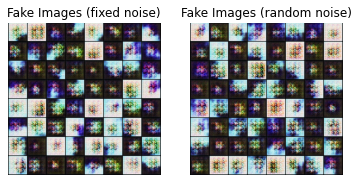

[43/125][0/29]	Loss_D: 0.6573	Loss_G: 2.5147	D(x): 0.6848	D(G(z)): 0.1589 / 0.0693
[43/125][5/29]	Loss_D: 1.3831	Loss_G: 5.9515	D(x): 0.8593	D(G(z)): 0.5266 / 0.0024
[43/125][10/29]	Loss_D: 0.6950	Loss_G: 2.4545	D(x): 0.8431	D(G(z)): 0.2796 / 0.0734
[43/125][15/29]	Loss_D: 0.6096	Loss_G: 3.5184	D(x): 0.8312	D(G(z)): 0.2123 / 0.0222
[43/125][20/29]	Loss_D: 0.9175	Loss_G: 1.7324	D(x): 0.4301	D(G(z)): 0.0389 / 0.2316
[43/125][25/29]	Loss_D: 0.5644	Loss_G: 2.9673	D(x): 0.8082	D(G(z)): 0.1681 / 0.0426


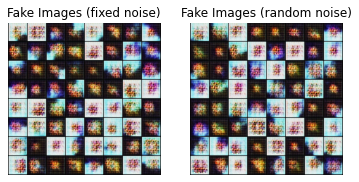

[44/125][0/29]	Loss_D: 0.7645	Loss_G: 1.3211	D(x): 0.5456	D(G(z)): 0.0937 / 0.2512
[44/125][5/29]	Loss_D: 1.4351	Loss_G: 2.8805	D(x): 0.9567	D(G(z)): 0.6088 / 0.0438
[44/125][10/29]	Loss_D: 1.1667	Loss_G: 4.1304	D(x): 0.8706	D(G(z)): 0.5354 / 0.0128
[44/125][15/29]	Loss_D: 0.5808	Loss_G: 2.6606	D(x): 0.8091	D(G(z)): 0.1890 / 0.0596
[44/125][20/29]	Loss_D: 0.6414	Loss_G: 4.2246	D(x): 0.8112	D(G(z)): 0.2367 / 0.0100
[44/125][25/29]	Loss_D: 0.5858	Loss_G: 4.2141	D(x): 0.8148	D(G(z)): 0.1905 / 0.0109


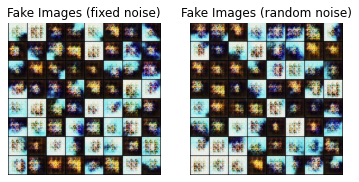

[45/125][0/29]	Loss_D: 0.7904	Loss_G: 2.3625	D(x): 0.8684	D(G(z)): 0.3341 / 0.0953
[45/125][5/29]	Loss_D: 0.7300	Loss_G: 2.6969	D(x): 0.7308	D(G(z)): 0.2560 / 0.0547
[45/125][10/29]	Loss_D: 0.8587	Loss_G: 1.4831	D(x): 0.4428	D(G(z)): 0.0265 / 0.2287
[45/125][15/29]	Loss_D: 0.7946	Loss_G: 2.1206	D(x): 0.5182	D(G(z)): 0.0171 / 0.1053
[45/125][20/29]	Loss_D: 0.7246	Loss_G: 1.5916	D(x): 0.5326	D(G(z)): 0.0321 / 0.1854
[45/125][25/29]	Loss_D: 0.6907	Loss_G: 3.8955	D(x): 0.8733	D(G(z)): 0.2853 / 0.0147


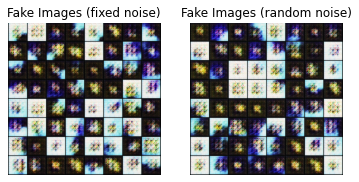

[46/125][0/29]	Loss_D: 0.5282	Loss_G: 2.7005	D(x): 0.7352	D(G(z)): 0.0934 / 0.0562
[46/125][5/29]	Loss_D: 0.7067	Loss_G: 5.4652	D(x): 0.8477	D(G(z)): 0.2854 / 0.0035
[46/125][10/29]	Loss_D: 0.8005	Loss_G: 2.2697	D(x): 0.7131	D(G(z)): 0.2372 / 0.0897
[46/125][15/29]	Loss_D: 0.7012	Loss_G: 2.5778	D(x): 0.6834	D(G(z)): 0.1918 / 0.0667
[46/125][20/29]	Loss_D: 0.5865	Loss_G: 2.8621	D(x): 0.7199	D(G(z)): 0.1299 / 0.0465
[46/125][25/29]	Loss_D: 0.6832	Loss_G: 1.7087	D(x): 0.5642	D(G(z)): 0.0192 / 0.2046


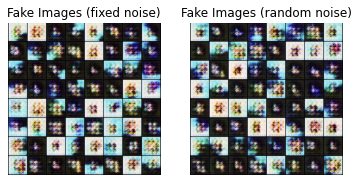

[47/125][0/29]	Loss_D: 0.6557	Loss_G: 2.0650	D(x): 0.5640	D(G(z)): 0.0229 / 0.1450
[47/125][5/29]	Loss_D: 0.9238	Loss_G: 0.9901	D(x): 0.4633	D(G(z)): 0.0900 / 0.3980
[47/125][10/29]	Loss_D: 0.6943	Loss_G: 1.9833	D(x): 0.6209	D(G(z)): 0.1200 / 0.1272
[47/125][15/29]	Loss_D: 0.6631	Loss_G: 2.0037	D(x): 0.6346	D(G(z)): 0.0988 / 0.1531
[47/125][20/29]	Loss_D: 0.6928	Loss_G: 3.4655	D(x): 0.8330	D(G(z)): 0.2755 / 0.0245
[47/125][25/29]	Loss_D: 2.3949	Loss_G: 1.5002	D(x): 0.0897	D(G(z)): 0.0030 / 0.2779


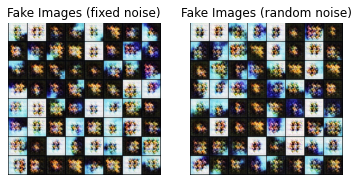

[48/125][0/29]	Loss_D: 0.8246	Loss_G: 2.1344	D(x): 0.5753	D(G(z)): 0.1772 / 0.1029
[48/125][5/29]	Loss_D: 0.8022	Loss_G: 2.6200	D(x): 0.6890	D(G(z)): 0.2654 / 0.0603
[48/125][10/29]	Loss_D: 0.6319	Loss_G: 2.8028	D(x): 0.6839	D(G(z)): 0.1328 / 0.0606
[48/125][15/29]	Loss_D: 0.7058	Loss_G: 3.6500	D(x): 0.8075	D(G(z)): 0.2772 / 0.0196
[48/125][20/29]	Loss_D: 0.6055	Loss_G: 2.6572	D(x): 0.6739	D(G(z)): 0.1006 / 0.0664
[48/125][25/29]	Loss_D: 0.8217	Loss_G: 1.9924	D(x): 0.6879	D(G(z)): 0.2554 / 0.1352


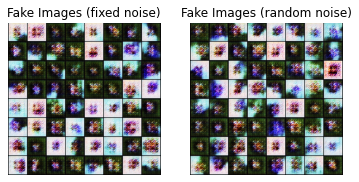

[49/125][0/29]	Loss_D: 0.6016	Loss_G: 2.6935	D(x): 0.7071	D(G(z)): 0.1327 / 0.0633
[49/125][5/29]	Loss_D: 0.5408	Loss_G: 2.7973	D(x): 0.7264	D(G(z)): 0.0977 / 0.0502
[49/125][10/29]	Loss_D: 0.5820	Loss_G: 3.2455	D(x): 0.7739	D(G(z)): 0.1661 / 0.0314
[49/125][15/29]	Loss_D: 0.7330	Loss_G: 4.4902	D(x): 0.8150	D(G(z)): 0.2660 / 0.0155
[49/125][20/29]	Loss_D: 0.5035	Loss_G: 3.5246	D(x): 0.8014	D(G(z)): 0.1083 / 0.0273
[49/125][25/29]	Loss_D: 0.9975	Loss_G: 1.8332	D(x): 0.3905	D(G(z)): 0.0269 / 0.1461


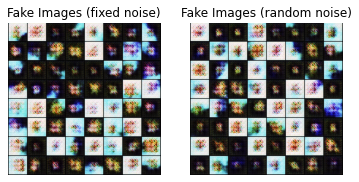

[50/125][0/29]	Loss_D: 0.7839	Loss_G: 2.2287	D(x): 0.5147	D(G(z)): 0.0708 / 0.1158
[50/125][5/29]	Loss_D: 0.6406	Loss_G: 3.4569	D(x): 0.8085	D(G(z)): 0.2160 / 0.0242
[50/125][10/29]	Loss_D: 0.5788	Loss_G: 2.7584	D(x): 0.6267	D(G(z)): 0.0334 / 0.0597
[50/125][15/29]	Loss_D: 0.6755	Loss_G: 3.9096	D(x): 0.8491	D(G(z)): 0.2435 / 0.0159
[50/125][20/29]	Loss_D: 0.8301	Loss_G: 2.0978	D(x): 0.4676	D(G(z)): 0.0213 / 0.1146
[50/125][25/29]	Loss_D: 0.7427	Loss_G: 2.9602	D(x): 0.8900	D(G(z)): 0.2841 / 0.0418


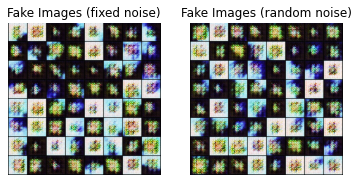

[51/125][0/29]	Loss_D: 0.5351	Loss_G: 2.4223	D(x): 0.6870	D(G(z)): 0.0613 / 0.0765
[51/125][5/29]	Loss_D: 0.7124	Loss_G: 1.7611	D(x): 0.5295	D(G(z)): 0.0246 / 0.1712
[51/125][10/29]	Loss_D: 3.1190	Loss_G: 2.0138	D(x): 0.9440	D(G(z)): 0.9018 / 0.1501
[51/125][15/29]	Loss_D: 0.7623	Loss_G: 2.1235	D(x): 0.6027	D(G(z)): 0.1594 / 0.1188
[51/125][20/29]	Loss_D: 0.8445	Loss_G: 1.3487	D(x): 0.4737	D(G(z)): 0.0462 / 0.2555
[51/125][25/29]	Loss_D: 0.6311	Loss_G: 2.1863	D(x): 0.6164	D(G(z)): 0.0702 / 0.1068


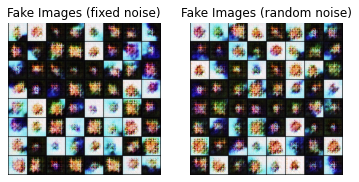

[52/125][0/29]	Loss_D: 0.8431	Loss_G: 3.6756	D(x): 0.8408	D(G(z)): 0.3693 / 0.0188
[52/125][5/29]	Loss_D: 0.5999	Loss_G: 2.3374	D(x): 0.6869	D(G(z)): 0.1150 / 0.0840
[52/125][10/29]	Loss_D: 0.8547	Loss_G: 4.5321	D(x): 0.9195	D(G(z)): 0.3914 / 0.0071
[52/125][15/29]	Loss_D: 0.5911	Loss_G: 2.9187	D(x): 0.6665	D(G(z)): 0.0908 / 0.0454
[52/125][20/29]	Loss_D: 1.2669	Loss_G: 1.1891	D(x): 0.3074	D(G(z)): 0.0538 / 0.3068
[52/125][25/29]	Loss_D: 0.7969	Loss_G: 2.5939	D(x): 0.8641	D(G(z)): 0.3353 / 0.0687


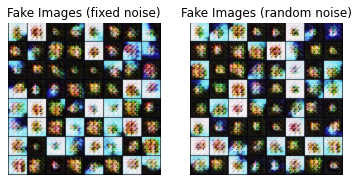

[53/125][0/29]	Loss_D: 0.5954	Loss_G: 2.9431	D(x): 0.7665	D(G(z)): 0.1705 / 0.0462
[53/125][5/29]	Loss_D: 0.7462	Loss_G: 4.3673	D(x): 0.8346	D(G(z)): 0.3161 / 0.0089
[53/125][10/29]	Loss_D: 0.7559	Loss_G: 2.9532	D(x): 0.6955	D(G(z)): 0.2408 / 0.0497
[53/125][15/29]	Loss_D: 0.5948	Loss_G: 2.3441	D(x): 0.6745	D(G(z)): 0.1025 / 0.0817
[53/125][20/29]	Loss_D: 0.5715	Loss_G: 2.7988	D(x): 0.6470	D(G(z)): 0.0566 / 0.0496
[53/125][25/29]	Loss_D: 0.6630	Loss_G: 1.5939	D(x): 0.5932	D(G(z)): 0.0633 / 0.2006


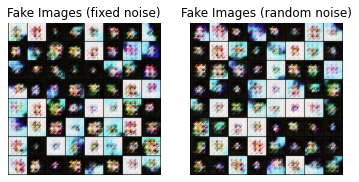

[54/125][0/29]	Loss_D: 0.5966	Loss_G: 2.2026	D(x): 0.6322	D(G(z)): 0.0526 / 0.0999
[54/125][5/29]	Loss_D: 1.3465	Loss_G: 4.4693	D(x): 0.9456	D(G(z)): 0.5927 / 0.0103
[54/125][10/29]	Loss_D: 0.5028	Loss_G: 2.9082	D(x): 0.7575	D(G(z)): 0.0890 / 0.0448
[54/125][15/29]	Loss_D: 0.9429	Loss_G: 1.0447	D(x): 0.4270	D(G(z)): 0.0414 / 0.3578
[54/125][20/29]	Loss_D: 0.5447	Loss_G: 2.8769	D(x): 0.7142	D(G(z)): 0.0928 / 0.0491
[54/125][25/29]	Loss_D: 1.2769	Loss_G: 4.5157	D(x): 0.8842	D(G(z)): 0.5191 / 0.0084


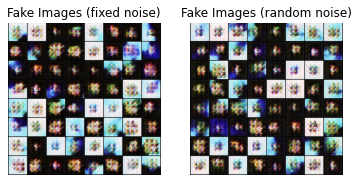

[55/125][0/29]	Loss_D: 0.5888	Loss_G: 2.9521	D(x): 0.8142	D(G(z)): 0.1903 / 0.0454
[55/125][5/29]	Loss_D: 0.6735	Loss_G: 3.6064	D(x): 0.7796	D(G(z)): 0.2360 / 0.0221
[55/125][10/29]	Loss_D: 0.8046	Loss_G: 1.8976	D(x): 0.5298	D(G(z)): 0.0883 / 0.1772
[55/125][15/29]	Loss_D: 0.8591	Loss_G: 3.4587	D(x): 0.8905	D(G(z)): 0.3625 / 0.0282
[55/125][20/29]	Loss_D: 0.7277	Loss_G: 4.2974	D(x): 0.8383	D(G(z)): 0.3028 / 0.0095
[55/125][25/29]	Loss_D: 0.6588	Loss_G: 4.1978	D(x): 0.8530	D(G(z)): 0.2592 / 0.0106


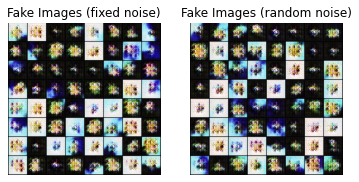

[56/125][0/29]	Loss_D: 1.0085	Loss_G: 4.0440	D(x): 0.8715	D(G(z)): 0.4418 / 0.0129
[56/125][5/29]	Loss_D: 0.7042	Loss_G: 2.6150	D(x): 0.7734	D(G(z)): 0.2207 / 0.0680
[56/125][10/29]	Loss_D: 0.7201	Loss_G: 1.7606	D(x): 0.5856	D(G(z)): 0.1162 / 0.1572
[56/125][15/29]	Loss_D: 0.8430	Loss_G: 2.7422	D(x): 0.8269	D(G(z)): 0.3504 / 0.0566
[56/125][20/29]	Loss_D: 0.6002	Loss_G: 2.4362	D(x): 0.6438	D(G(z)): 0.0770 / 0.0775
[56/125][25/29]	Loss_D: 0.5358	Loss_G: 3.2694	D(x): 0.8119	D(G(z)): 0.1489 / 0.0309


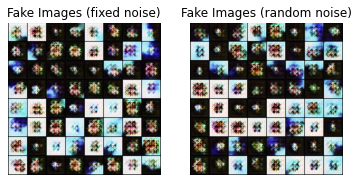

[57/125][0/29]	Loss_D: 0.5148	Loss_G: 3.2479	D(x): 0.8291	D(G(z)): 0.1425 / 0.0313
[57/125][5/29]	Loss_D: 1.4624	Loss_G: 1.3845	D(x): 0.2530	D(G(z)): 0.0105 / 0.2764
[57/125][10/29]	Loss_D: 1.1944	Loss_G: 4.7137	D(x): 0.8805	D(G(z)): 0.5303 / 0.0093
[57/125][15/29]	Loss_D: 0.5899	Loss_G: 2.2981	D(x): 0.8092	D(G(z)): 0.1808 / 0.0976
[57/125][20/29]	Loss_D: 0.6905	Loss_G: 2.9793	D(x): 0.7542	D(G(z)): 0.2367 / 0.0440
[57/125][25/29]	Loss_D: 1.2095	Loss_G: 1.6290	D(x): 0.3243	D(G(z)): 0.0658 / 0.1729


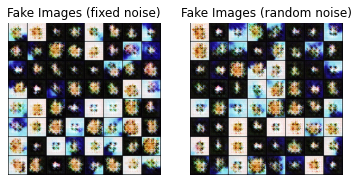

[58/125][0/29]	Loss_D: 0.5914	Loss_G: 2.6745	D(x): 0.7439	D(G(z)): 0.1538 / 0.0591
[58/125][5/29]	Loss_D: 0.6103	Loss_G: 2.3694	D(x): 0.6452	D(G(z)): 0.0780 / 0.0818
[58/125][10/29]	Loss_D: 0.6709	Loss_G: 1.9843	D(x): 0.5702	D(G(z)): 0.0476 / 0.1240
[58/125][15/29]	Loss_D: 0.7219	Loss_G: 3.9053	D(x): 0.8280	D(G(z)): 0.2872 / 0.0177
[58/125][20/29]	Loss_D: 0.7682	Loss_G: 1.6198	D(x): 0.5109	D(G(z)): 0.0373 / 0.1990
[58/125][25/29]	Loss_D: 0.6048	Loss_G: 2.1786	D(x): 0.6773	D(G(z)): 0.1069 / 0.1033


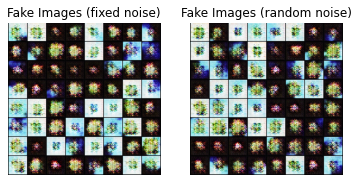

[59/125][0/29]	Loss_D: 0.7917	Loss_G: 2.0551	D(x): 0.4917	D(G(z)): 0.0337 / 0.1144
[59/125][5/29]	Loss_D: 0.5718	Loss_G: 2.1658	D(x): 0.7010	D(G(z)): 0.1102 / 0.1045
[59/125][10/29]	Loss_D: 0.5259	Loss_G: 2.5440	D(x): 0.7462	D(G(z)): 0.0988 / 0.0702
[59/125][15/29]	Loss_D: 0.5547	Loss_G: 2.2400	D(x): 0.6548	D(G(z)): 0.0386 / 0.0954
[59/125][20/29]	Loss_D: 0.6817	Loss_G: 4.0780	D(x): 0.8981	D(G(z)): 0.2824 / 0.0127
[59/125][25/29]	Loss_D: 0.5501	Loss_G: 3.0026	D(x): 0.7805	D(G(z)): 0.1362 / 0.0433


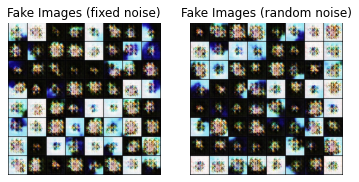

[60/125][0/29]	Loss_D: 0.5981	Loss_G: 2.3442	D(x): 0.7044	D(G(z)): 0.1281 / 0.0841
[60/125][5/29]	Loss_D: 0.9189	Loss_G: 1.7825	D(x): 0.8513	D(G(z)): 0.4175 / 0.1606
[60/125][10/29]	Loss_D: 0.5937	Loss_G: 2.3496	D(x): 0.7552	D(G(z)): 0.1694 / 0.0876
[60/125][15/29]	Loss_D: 1.1319	Loss_G: 3.4233	D(x): 0.8748	D(G(z)): 0.5137 / 0.0254
[60/125][20/29]	Loss_D: 0.7319	Loss_G: 1.5225	D(x): 0.6139	D(G(z)): 0.1431 / 0.2071
[60/125][25/29]	Loss_D: 1.0851	Loss_G: 2.5935	D(x): 0.9146	D(G(z)): 0.4617 / 0.0713


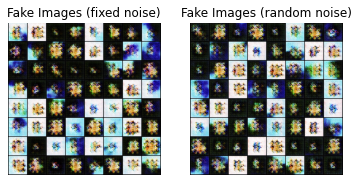

[61/125][0/29]	Loss_D: 0.6145	Loss_G: 3.1921	D(x): 0.8398	D(G(z)): 0.2200 / 0.0341
[61/125][5/29]	Loss_D: 0.6633	Loss_G: 2.9373	D(x): 0.7593	D(G(z)): 0.2135 / 0.0452
[61/125][10/29]	Loss_D: 1.0209	Loss_G: 3.2730	D(x): 0.8773	D(G(z)): 0.4606 / 0.0312
[61/125][15/29]	Loss_D: 0.5459	Loss_G: 2.9504	D(x): 0.8256	D(G(z)): 0.1657 / 0.0414
[61/125][20/29]	Loss_D: 0.9012	Loss_G: 1.3903	D(x): 0.4334	D(G(z)): 0.0345 / 0.2397
[61/125][25/29]	Loss_D: 0.5534	Loss_G: 2.2156	D(x): 0.6706	D(G(z)): 0.0551 / 0.0983


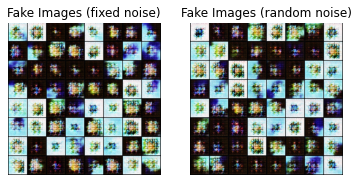

[62/125][0/29]	Loss_D: 0.9163	Loss_G: 1.8345	D(x): 0.4208	D(G(z)): 0.0214 / 0.1712
[62/125][5/29]	Loss_D: 0.5294	Loss_G: 2.8670	D(x): 0.7267	D(G(z)): 0.0881 / 0.0481
[62/125][10/29]	Loss_D: 0.8675	Loss_G: 1.4175	D(x): 0.4551	D(G(z)): 0.0517 / 0.2430
[62/125][15/29]	Loss_D: 0.9151	Loss_G: 2.1636	D(x): 0.8631	D(G(z)): 0.4130 / 0.1062
[62/125][20/29]	Loss_D: 0.7656	Loss_G: 3.2606	D(x): 0.7965	D(G(z)): 0.2961 / 0.0338
[62/125][25/29]	Loss_D: 0.5943	Loss_G: 3.2206	D(x): 0.8097	D(G(z)): 0.1882 / 0.0310


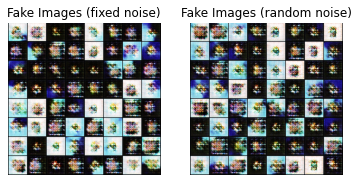

[63/125][0/29]	Loss_D: 0.8197	Loss_G: 4.4766	D(x): 0.8221	D(G(z)): 0.3556 / 0.0088
[63/125][5/29]	Loss_D: 0.5458	Loss_G: 2.9293	D(x): 0.6681	D(G(z)): 0.0513 / 0.0473
[63/125][10/29]	Loss_D: 1.6888	Loss_G: 0.5192	D(x): 0.1792	D(G(z)): 0.0148 / 0.6455
[63/125][15/29]	Loss_D: 0.7129	Loss_G: 2.3208	D(x): 0.5758	D(G(z)): 0.1014 / 0.0863
[63/125][20/29]	Loss_D: 0.7565	Loss_G: 3.5161	D(x): 0.7923	D(G(z)): 0.3041 / 0.0232
[63/125][25/29]	Loss_D: 0.5029	Loss_G: 3.3560	D(x): 0.7622	D(G(z)): 0.0951 / 0.0276


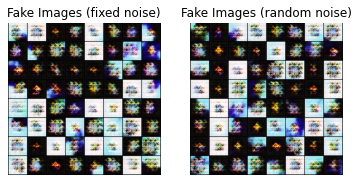

[64/125][0/29]	Loss_D: 0.5712	Loss_G: 2.8388	D(x): 0.7574	D(G(z)): 0.1448 / 0.0485
[64/125][5/29]	Loss_D: 0.8982	Loss_G: 3.8591	D(x): 0.8895	D(G(z)): 0.3991 / 0.0163
[64/125][10/29]	Loss_D: 0.6469	Loss_G: 1.9894	D(x): 0.6458	D(G(z)): 0.1128 / 0.1283
[64/125][15/29]	Loss_D: 1.0546	Loss_G: 4.9898	D(x): 0.9502	D(G(z)): 0.4802 / 0.0053
[64/125][20/29]	Loss_D: 0.7141	Loss_G: 3.7310	D(x): 0.8394	D(G(z)): 0.2920 / 0.0184
[64/125][25/29]	Loss_D: 0.5222	Loss_G: 3.0593	D(x): 0.7107	D(G(z)): 0.0718 / 0.0398


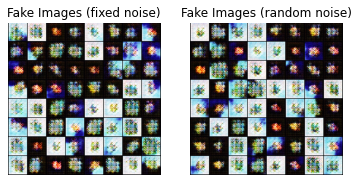

[65/125][0/29]	Loss_D: 0.4560	Loss_G: 3.1838	D(x): 0.8287	D(G(z)): 0.0897 / 0.0365
[65/125][5/29]	Loss_D: 0.5383	Loss_G: 3.3555	D(x): 0.8183	D(G(z)): 0.1518 / 0.0293
[65/125][10/29]	Loss_D: 0.6499	Loss_G: 4.6912	D(x): 0.8860	D(G(z)): 0.2560 / 0.0077
[65/125][15/29]	Loss_D: 2.8169	Loss_G: 0.7016	D(x): 0.0567	D(G(z)): 0.0032 / 0.5374
[65/125][20/29]	Loss_D: 0.7749	Loss_G: 2.7848	D(x): 0.8349	D(G(z)): 0.3280 / 0.0564
[65/125][25/29]	Loss_D: 0.5424	Loss_G: 2.7150	D(x): 0.7805	D(G(z)): 0.1363 / 0.0619


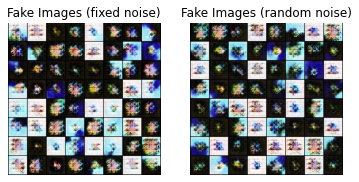

[66/125][0/29]	Loss_D: 0.6594	Loss_G: 2.0277	D(x): 0.5958	D(G(z)): 0.0586 / 0.1627
[66/125][5/29]	Loss_D: 0.5473	Loss_G: 2.2027	D(x): 0.7048	D(G(z)): 0.0863 / 0.1053
[66/125][10/29]	Loss_D: 0.5123	Loss_G: 3.0201	D(x): 0.7998	D(G(z)): 0.1276 / 0.0404
[66/125][15/29]	Loss_D: 1.4777	Loss_G: 1.2296	D(x): 0.2594	D(G(z)): 0.0132 / 0.2862
[66/125][20/29]	Loss_D: 0.5456	Loss_G: 2.8643	D(x): 0.6920	D(G(z)): 0.0689 / 0.0459
[66/125][25/29]	Loss_D: 0.5841	Loss_G: 2.2195	D(x): 0.6703	D(G(z)): 0.0873 / 0.0940


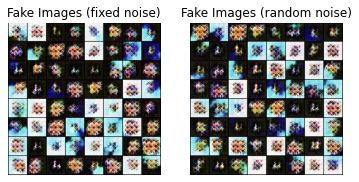

[67/125][0/29]	Loss_D: 0.6595	Loss_G: 3.3984	D(x): 0.8442	D(G(z)): 0.2597 / 0.0253
[67/125][5/29]	Loss_D: 0.7119	Loss_G: 1.2784	D(x): 0.5643	D(G(z)): 0.0763 / 0.2690
[67/125][10/29]	Loss_D: 0.6744	Loss_G: 3.0931	D(x): 0.9294	D(G(z)): 0.2762 / 0.0398
[67/125][15/29]	Loss_D: 0.7425	Loss_G: 3.9032	D(x): 0.8388	D(G(z)): 0.2949 / 0.0194
[67/125][20/29]	Loss_D: 0.8879	Loss_G: 0.8856	D(x): 0.4535	D(G(z)): 0.0578 / 0.4345
[67/125][25/29]	Loss_D: 0.6885	Loss_G: 1.3634	D(x): 0.5765	D(G(z)): 0.0719 / 0.2527


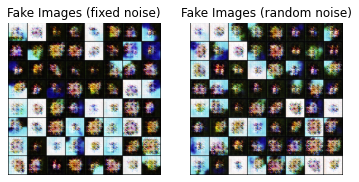

[68/125][0/29]	Loss_D: 0.5164	Loss_G: 3.4210	D(x): 0.7281	D(G(z)): 0.0772 / 0.0306
[68/125][5/29]	Loss_D: 0.8789	Loss_G: 4.3119	D(x): 0.8944	D(G(z)): 0.3872 / 0.0118
[68/125][10/29]	Loss_D: 0.6088	Loss_G: 3.4258	D(x): 0.8240	D(G(z)): 0.2111 / 0.0246
[68/125][15/29]	Loss_D: 0.6655	Loss_G: 2.6934	D(x): 0.5723	D(G(z)): 0.0401 / 0.0585
[68/125][20/29]	Loss_D: 0.5577	Loss_G: 2.9454	D(x): 0.7483	D(G(z)): 0.1287 / 0.0475
[68/125][25/29]	Loss_D: 0.5979	Loss_G: 4.2279	D(x): 0.8803	D(G(z)): 0.2103 / 0.0105


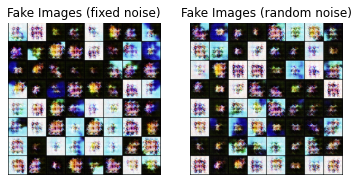

[69/125][0/29]	Loss_D: 0.6167	Loss_G: 3.7825	D(x): 0.9123	D(G(z)): 0.2364 / 0.0183
[69/125][5/29]	Loss_D: 0.7846	Loss_G: 2.0313	D(x): 0.5921	D(G(z)): 0.1460 / 0.1245
[69/125][10/29]	Loss_D: 1.1774	Loss_G: 3.9591	D(x): 0.9250	D(G(z)): 0.5175 / 0.0173
[69/125][15/29]	Loss_D: 0.5742	Loss_G: 2.6744	D(x): 0.7269	D(G(z)): 0.1204 / 0.0617
[69/125][20/29]	Loss_D: 0.7311	Loss_G: 2.8144	D(x): 0.5491	D(G(z)): 0.0286 / 0.0771
[69/125][25/29]	Loss_D: 0.6044	Loss_G: 2.5146	D(x): 0.6133	D(G(z)): 0.0382 / 0.0761


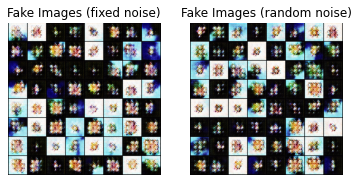

[70/125][0/29]	Loss_D: 0.5781	Loss_G: 2.5553	D(x): 0.7143	D(G(z)): 0.1197 / 0.0696
[70/125][5/29]	Loss_D: 0.4792	Loss_G: 3.1137	D(x): 0.8725	D(G(z)): 0.1232 / 0.0436
[70/125][10/29]	Loss_D: 0.4623	Loss_G: 2.9630	D(x): 0.8193	D(G(z)): 0.0830 / 0.0448
[70/125][15/29]	Loss_D: 0.5968	Loss_G: 3.9930	D(x): 0.7949	D(G(z)): 0.1878 / 0.0143
[70/125][20/29]	Loss_D: 1.2741	Loss_G: 1.6752	D(x): 0.2970	D(G(z)): 0.0222 / 0.1853
[70/125][25/29]	Loss_D: 0.5503	Loss_G: 3.1359	D(x): 0.7857	D(G(z)): 0.1467 / 0.0364


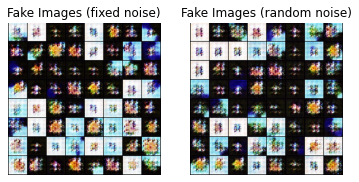

[71/125][0/29]	Loss_D: 1.2450	Loss_G: 3.4106	D(x): 0.9124	D(G(z)): 0.5536 / 0.0352
[71/125][5/29]	Loss_D: 0.7218	Loss_G: 3.7166	D(x): 0.8599	D(G(z)): 0.2938 / 0.0189
[71/125][10/29]	Loss_D: 0.9960	Loss_G: 2.1388	D(x): 0.4016	D(G(z)): 0.0187 / 0.1363
[71/125][15/29]	Loss_D: 0.4494	Loss_G: 4.0314	D(x): 0.7582	D(G(z)): 0.0394 / 0.0132
[71/125][20/29]	Loss_D: 0.7540	Loss_G: 3.9393	D(x): 0.9158	D(G(z)): 0.3292 / 0.0140
[71/125][25/29]	Loss_D: 0.4967	Loss_G: 3.3154	D(x): 0.8108	D(G(z)): 0.1175 / 0.0298


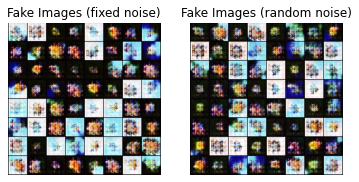

[72/125][0/29]	Loss_D: 0.7481	Loss_G: 1.6448	D(x): 0.5013	D(G(z)): 0.0220 / 0.1807
[72/125][5/29]	Loss_D: 0.4822	Loss_G: 3.1219	D(x): 0.7705	D(G(z)): 0.0763 / 0.0388
[72/125][10/29]	Loss_D: 1.0764	Loss_G: 0.7375	D(x): 0.3571	D(G(z)): 0.0207 / 0.4980
[72/125][15/29]	Loss_D: 0.5295	Loss_G: 3.1720	D(x): 0.7647	D(G(z)): 0.1165 / 0.0367
[72/125][20/29]	Loss_D: 0.9327	Loss_G: 4.6447	D(x): 0.9062	D(G(z)): 0.4207 / 0.0074
[72/125][25/29]	Loss_D: 0.7223	Loss_G: 2.8757	D(x): 0.5301	D(G(z)): 0.0219 / 0.0470


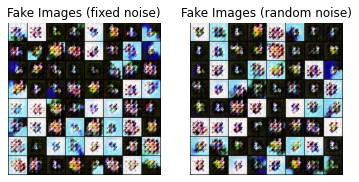

[73/125][0/29]	Loss_D: 0.5550	Loss_G: 3.3329	D(x): 0.8777	D(G(z)): 0.1856 / 0.0292
[73/125][5/29]	Loss_D: 0.4870	Loss_G: 3.1963	D(x): 0.8292	D(G(z)): 0.1199 / 0.0326
[73/125][10/29]	Loss_D: 1.0667	Loss_G: 1.0079	D(x): 0.3846	D(G(z)): 0.0275 / 0.4201
[73/125][15/29]	Loss_D: 1.2832	Loss_G: 2.1110	D(x): 0.9267	D(G(z)): 0.5924 / 0.1147
[73/125][20/29]	Loss_D: 0.5954	Loss_G: 2.6498	D(x): 0.6852	D(G(z)): 0.1085 / 0.0618
[73/125][25/29]	Loss_D: 0.6268	Loss_G: 2.5894	D(x): 0.7507	D(G(z)): 0.1859 / 0.0668


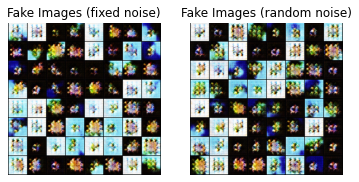

[74/125][0/29]	Loss_D: 0.7580	Loss_G: 1.5635	D(x): 0.5711	D(G(z)): 0.1035 / 0.2341
[74/125][5/29]	Loss_D: 0.4741	Loss_G: 2.3473	D(x): 0.7892	D(G(z)): 0.0845 / 0.0857
[74/125][10/29]	Loss_D: 0.6599	Loss_G: 2.2423	D(x): 0.6055	D(G(z)): 0.0498 / 0.0957
[74/125][15/29]	Loss_D: 0.6881	Loss_G: 3.0719	D(x): 0.6897	D(G(z)): 0.1837 / 0.0421
[74/125][20/29]	Loss_D: 1.7433	Loss_G: 1.7064	D(x): 0.1923	D(G(z)): 0.0032 / 0.1817
[74/125][25/29]	Loss_D: 0.6229	Loss_G: 2.5454	D(x): 0.6249	D(G(z)): 0.0681 / 0.0734


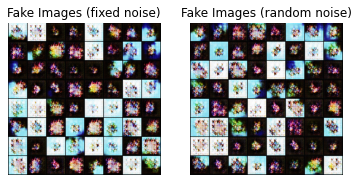

[75/125][0/29]	Loss_D: 0.6994	Loss_G: 1.7528	D(x): 0.5749	D(G(z)): 0.0685 / 0.2094
[75/125][5/29]	Loss_D: 0.4591	Loss_G: 3.1199	D(x): 0.7530	D(G(z)): 0.0433 / 0.0354
[75/125][10/29]	Loss_D: 0.6643	Loss_G: 2.5567	D(x): 0.6866	D(G(z)): 0.1682 / 0.0686
[75/125][15/29]	Loss_D: 0.6012	Loss_G: 3.0906	D(x): 0.8975	D(G(z)): 0.2247 / 0.0387
[75/125][20/29]	Loss_D: 0.6683	Loss_G: 2.5919	D(x): 0.6836	D(G(z)): 0.1651 / 0.0652
[75/125][25/29]	Loss_D: 0.6703	Loss_G: 3.4823	D(x): 0.8646	D(G(z)): 0.2687 / 0.0234


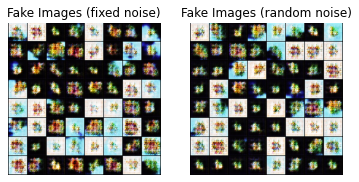

[76/125][0/29]	Loss_D: 0.5405	Loss_G: 3.0306	D(x): 0.7866	D(G(z)): 0.1385 / 0.0397
[76/125][5/29]	Loss_D: 1.6398	Loss_G: 0.8599	D(x): 0.2134	D(G(z)): 0.0095 / 0.4291
[76/125][10/29]	Loss_D: 0.7608	Loss_G: 1.7313	D(x): 0.5260	D(G(z)): 0.0702 / 0.1667
[76/125][15/29]	Loss_D: 0.8197	Loss_G: 3.1292	D(x): 0.9218	D(G(z)): 0.3617 / 0.0349
[76/125][20/29]	Loss_D: 0.7350	Loss_G: 1.4723	D(x): 0.5543	D(G(z)): 0.0722 / 0.2165
[76/125][25/29]	Loss_D: 0.6558	Loss_G: 2.2167	D(x): 0.6798	D(G(z)): 0.1516 / 0.0963


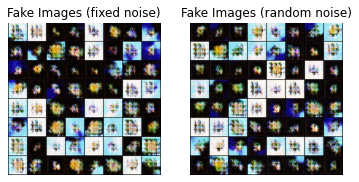

[77/125][0/29]	Loss_D: 1.0287	Loss_G: 1.7790	D(x): 0.3706	D(G(z)): 0.0217 / 0.1668
[77/125][5/29]	Loss_D: 0.4765	Loss_G: 3.2473	D(x): 0.7805	D(G(z)): 0.0812 / 0.0337
[77/125][10/29]	Loss_D: 1.0796	Loss_G: 1.8431	D(x): 0.3664	D(G(z)): 0.0198 / 0.1964
[77/125][15/29]	Loss_D: 0.5664	Loss_G: 2.4627	D(x): 0.7352	D(G(z)): 0.1253 / 0.0728
[77/125][20/29]	Loss_D: 0.9985	Loss_G: 4.0664	D(x): 0.8571	D(G(z)): 0.4642 / 0.0129
[77/125][25/29]	Loss_D: 0.5633	Loss_G: 2.6295	D(x): 0.7792	D(G(z)): 0.1428 / 0.0628


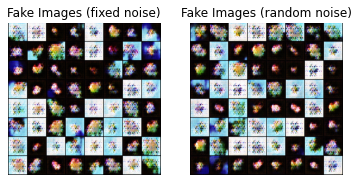

[78/125][0/29]	Loss_D: 0.5919	Loss_G: 3.1732	D(x): 0.7706	D(G(z)): 0.1661 / 0.0355
[78/125][5/29]	Loss_D: 0.7283	Loss_G: 1.8959	D(x): 0.5597	D(G(z)): 0.0723 / 0.1499
[78/125][10/29]	Loss_D: 1.2618	Loss_G: 4.7729	D(x): 0.9188	D(G(z)): 0.5670 / 0.0073
[78/125][15/29]	Loss_D: 0.7179	Loss_G: 1.6963	D(x): 0.5715	D(G(z)): 0.0619 / 0.1942
[78/125][20/29]	Loss_D: 0.4440	Loss_G: 3.4265	D(x): 0.8638	D(G(z)): 0.0879 / 0.0277
[78/125][25/29]	Loss_D: 0.5641	Loss_G: 3.3166	D(x): 0.7982	D(G(z)): 0.1577 / 0.0295


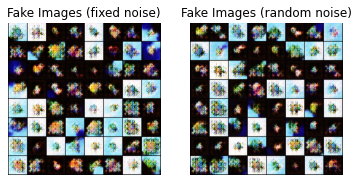

[79/125][0/29]	Loss_D: 1.6791	Loss_G: 4.9536	D(x): 0.9613	D(G(z)): 0.6825 / 0.0059
[79/125][5/29]	Loss_D: 0.9394	Loss_G: 2.8026	D(x): 0.7004	D(G(z)): 0.3025 / 0.0547
[79/125][10/29]	Loss_D: 0.6079	Loss_G: 3.0751	D(x): 0.7699	D(G(z)): 0.1725 / 0.0414
[79/125][15/29]	Loss_D: 0.5635	Loss_G: 2.7177	D(x): 0.7527	D(G(z)): 0.1363 / 0.0562
[79/125][20/29]	Loss_D: 0.5834	Loss_G: 2.9750	D(x): 0.7549	D(G(z)): 0.1460 / 0.0449
[79/125][25/29]	Loss_D: 0.5427	Loss_G: 3.7118	D(x): 0.6708	D(G(z)): 0.0377 / 0.0203


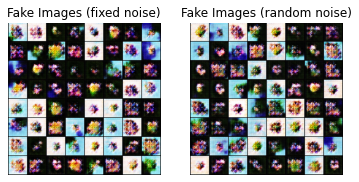

[80/125][0/29]	Loss_D: 0.5024	Loss_G: 2.6903	D(x): 0.7408	D(G(z)): 0.0707 / 0.0602
[80/125][5/29]	Loss_D: 1.0903	Loss_G: 1.2662	D(x): 0.4271	D(G(z)): 0.0310 / 0.3137
[80/125][10/29]	Loss_D: 0.5770	Loss_G: 2.2588	D(x): 0.6600	D(G(z)): 0.0502 / 0.0994
[80/125][15/29]	Loss_D: 0.5463	Loss_G: 2.5702	D(x): 0.8651	D(G(z)): 0.1721 / 0.0704
[80/125][20/29]	Loss_D: 0.5838	Loss_G: 1.9777	D(x): 0.6981	D(G(z)): 0.0961 / 0.1260
[80/125][25/29]	Loss_D: 0.5700	Loss_G: 2.2935	D(x): 0.7124	D(G(z)): 0.1109 / 0.0967


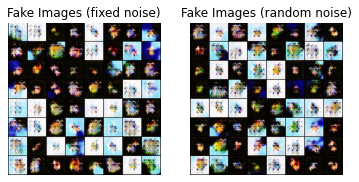

[81/125][0/29]	Loss_D: 0.8545	Loss_G: 4.9711	D(x): 0.8330	D(G(z)): 0.3506 / 0.0054
[81/125][5/29]	Loss_D: 1.1645	Loss_G: 0.9652	D(x): 0.3342	D(G(z)): 0.0467 / 0.3891
[81/125][10/29]	Loss_D: 0.7973	Loss_G: 1.4433	D(x): 0.5403	D(G(z)): 0.1135 / 0.2721
[81/125][15/29]	Loss_D: 0.6285	Loss_G: 2.3705	D(x): 0.6572	D(G(z)): 0.0960 / 0.0864
[81/125][20/29]	Loss_D: 0.4558	Loss_G: 2.7807	D(x): 0.7991	D(G(z)): 0.0668 / 0.0582
[81/125][25/29]	Loss_D: 0.7351	Loss_G: 2.7200	D(x): 0.7113	D(G(z)): 0.2375 / 0.0560


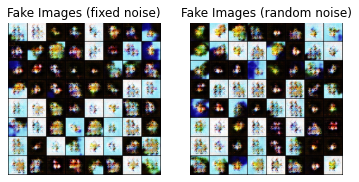

[82/125][0/29]	Loss_D: 0.7898	Loss_G: 1.5708	D(x): 0.5375	D(G(z)): 0.1030 / 0.2051
[82/125][5/29]	Loss_D: 0.6916	Loss_G: 1.7888	D(x): 0.5654	D(G(z)): 0.0567 / 0.1814
[82/125][10/29]	Loss_D: 0.5977	Loss_G: 2.5069	D(x): 0.7529	D(G(z)): 0.1617 / 0.0734
[82/125][15/29]	Loss_D: 0.7446	Loss_G: 3.3841	D(x): 0.8886	D(G(z)): 0.3201 / 0.0267
[82/125][20/29]	Loss_D: 0.8028	Loss_G: 2.6142	D(x): 0.8787	D(G(z)): 0.3516 / 0.0674
[82/125][25/29]	Loss_D: 0.5991	Loss_G: 3.1259	D(x): 0.7850	D(G(z)): 0.1808 / 0.0357


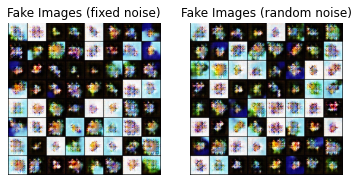

[83/125][0/29]	Loss_D: 0.7315	Loss_G: 0.7865	D(x): 0.5515	D(G(z)): 0.0715 / 0.4664
[83/125][5/29]	Loss_D: 1.7259	Loss_G: 5.1622	D(x): 0.9582	D(G(z)): 0.7217 / 0.0043
[83/125][10/29]	Loss_D: 0.5888	Loss_G: 2.7725	D(x): 0.8059	D(G(z)): 0.1700 / 0.0517
[83/125][15/29]	Loss_D: 2.7660	Loss_G: 3.9925	D(x): 0.9783	D(G(z)): 0.8796 / 0.0189
[83/125][20/29]	Loss_D: 1.0717	Loss_G: 1.9021	D(x): 0.7431	D(G(z)): 0.4485 / 0.1338
[83/125][25/29]	Loss_D: 0.8072	Loss_G: 3.7092	D(x): 0.8642	D(G(z)): 0.3529 / 0.0201


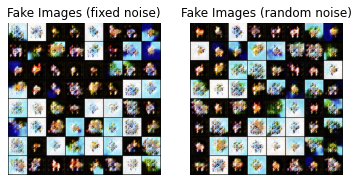

[84/125][0/29]	Loss_D: 0.6465	Loss_G: 1.8886	D(x): 0.7076	D(G(z)): 0.1663 / 0.1457
[84/125][5/29]	Loss_D: 0.6998	Loss_G: 2.1020	D(x): 0.6316	D(G(z)): 0.1410 / 0.1172
[84/125][10/29]	Loss_D: 0.5334	Loss_G: 2.8652	D(x): 0.7888	D(G(z)): 0.1322 / 0.0476
[84/125][15/29]	Loss_D: 0.6623	Loss_G: 2.6033	D(x): 0.7393	D(G(z)): 0.2053 / 0.0636
[84/125][20/29]	Loss_D: 0.6326	Loss_G: 1.8317	D(x): 0.6697	D(G(z)): 0.1261 / 0.1487
[84/125][25/29]	Loss_D: 0.6066	Loss_G: 2.8742	D(x): 0.8801	D(G(z)): 0.2183 / 0.0515


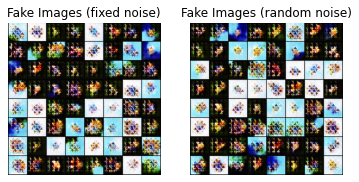

[85/125][0/29]	Loss_D: 0.5161	Loss_G: 3.3339	D(x): 0.8457	D(G(z)): 0.1468 / 0.0291
[85/125][5/29]	Loss_D: 0.6216	Loss_G: 2.1262	D(x): 0.6236	D(G(z)): 0.0715 / 0.1072
[85/125][10/29]	Loss_D: 0.7433	Loss_G: 2.6696	D(x): 0.8118	D(G(z)): 0.2954 / 0.0648
[85/125][15/29]	Loss_D: 0.6678	Loss_G: 2.9070	D(x): 0.8170	D(G(z)): 0.2430 / 0.0487
[85/125][20/29]	Loss_D: 1.5619	Loss_G: 4.4321	D(x): 0.9550	D(G(z)): 0.6513 / 0.0095
[85/125][25/29]	Loss_D: 0.8940	Loss_G: 3.6893	D(x): 0.9316	D(G(z)): 0.3910 / 0.0205


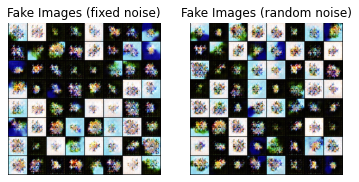

[86/125][0/29]	Loss_D: 0.7057	Loss_G: 3.8207	D(x): 0.8473	D(G(z)): 0.2854 / 0.0162
[86/125][5/29]	Loss_D: 0.7899	Loss_G: 3.9779	D(x): 0.8940	D(G(z)): 0.3467 / 0.0143
[86/125][10/29]	Loss_D: 0.6855	Loss_G: 1.8277	D(x): 0.5551	D(G(z)): 0.0329 / 0.1584
[86/125][15/29]	Loss_D: 0.5272	Loss_G: 2.9540	D(x): 0.7846	D(G(z)): 0.1177 / 0.0458
[86/125][20/29]	Loss_D: 0.6933	Loss_G: 2.1780	D(x): 0.6290	D(G(z)): 0.1320 / 0.1023
[86/125][25/29]	Loss_D: 0.5639	Loss_G: 3.4496	D(x): 0.8437	D(G(z)): 0.1828 / 0.0253


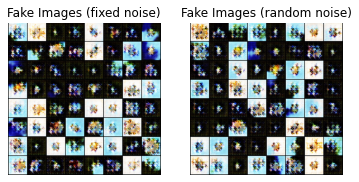

[87/125][0/29]	Loss_D: 0.8685	Loss_G: 3.4123	D(x): 0.9205	D(G(z)): 0.3942 / 0.0278
[87/125][5/29]	Loss_D: 0.4830	Loss_G: 2.8510	D(x): 0.8322	D(G(z)): 0.1136 / 0.0497
[87/125][10/29]	Loss_D: 0.5255	Loss_G: 3.1765	D(x): 0.8156	D(G(z)): 0.1434 / 0.0336
[87/125][15/29]	Loss_D: 1.0453	Loss_G: 1.4061	D(x): 0.3833	D(G(z)): 0.0231 / 0.2488
[87/125][20/29]	Loss_D: 0.6514	Loss_G: 3.2630	D(x): 0.9180	D(G(z)): 0.2465 / 0.0363
[87/125][25/29]	Loss_D: 0.6381	Loss_G: 1.7457	D(x): 0.6417	D(G(z)): 0.0958 / 0.1643


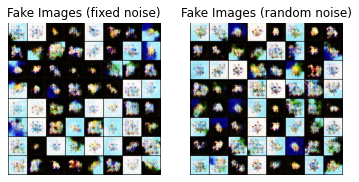

[88/125][0/29]	Loss_D: 0.9814	Loss_G: 1.5519	D(x): 0.4242	D(G(z)): 0.0430 / 0.2439
[88/125][5/29]	Loss_D: 0.4867	Loss_G: 3.7395	D(x): 0.8832	D(G(z)): 0.1321 / 0.0191
[88/125][10/29]	Loss_D: 0.5919	Loss_G: 5.1088	D(x): 0.9092	D(G(z)): 0.2139 / 0.0043
[88/125][15/29]	Loss_D: 0.8796	Loss_G: 2.7283	D(x): 0.6075	D(G(z)): 0.1593 / 0.0662
[88/125][20/29]	Loss_D: 1.1584	Loss_G: 0.6807	D(x): 0.4028	D(G(z)): 0.0962 / 0.5481
[88/125][25/29]	Loss_D: 0.8048	Loss_G: 1.6236	D(x): 0.5584	D(G(z)): 0.1351 / 0.2053


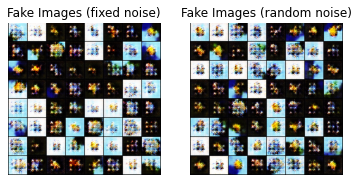

[89/125][0/29]	Loss_D: 0.8211	Loss_G: 2.6340	D(x): 0.7621	D(G(z)): 0.3293 / 0.0616
[89/125][5/29]	Loss_D: 0.8517	Loss_G: 2.0745	D(x): 0.6217	D(G(z)): 0.2446 / 0.1120
[89/125][10/29]	Loss_D: 0.5353	Loss_G: 2.6151	D(x): 0.7983	D(G(z)): 0.1400 / 0.0631
[89/125][15/29]	Loss_D: 0.5146	Loss_G: 2.5628	D(x): 0.7173	D(G(z)): 0.0615 / 0.0697
[89/125][20/29]	Loss_D: 0.7976	Loss_G: 2.0826	D(x): 0.6720	D(G(z)): 0.2478 / 0.1161
[89/125][25/29]	Loss_D: 0.5233	Loss_G: 2.2526	D(x): 0.8034	D(G(z)): 0.1325 / 0.0948


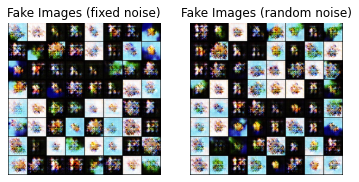

[90/125][0/29]	Loss_D: 0.5535	Loss_G: 3.4771	D(x): 0.8520	D(G(z)): 0.1789 / 0.0278
[90/125][5/29]	Loss_D: 0.6680	Loss_G: 1.9843	D(x): 0.6785	D(G(z)): 0.1320 / 0.1348
[90/125][10/29]	Loss_D: 0.6436	Loss_G: 3.8857	D(x): 0.8544	D(G(z)): 0.2475 / 0.0226
[90/125][15/29]	Loss_D: 1.1473	Loss_G: 0.7545	D(x): 0.3280	D(G(z)): 0.0163 / 0.5217
[90/125][20/29]	Loss_D: 0.5106	Loss_G: 2.7144	D(x): 0.8196	D(G(z)): 0.1339 / 0.0564
[90/125][25/29]	Loss_D: 0.7714	Loss_G: 3.1891	D(x): 0.7820	D(G(z)): 0.2981 / 0.0352


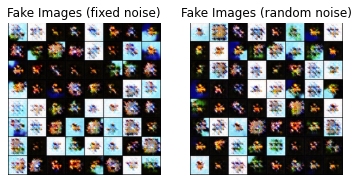

[91/125][0/29]	Loss_D: 0.6774	Loss_G: 3.8923	D(x): 0.8969	D(G(z)): 0.2752 / 0.0172
[91/125][5/29]	Loss_D: 0.4587	Loss_G: 3.2795	D(x): 0.8583	D(G(z)): 0.1028 / 0.0292
[91/125][10/29]	Loss_D: 0.5669	Loss_G: 2.3483	D(x): 0.6848	D(G(z)): 0.0822 / 0.0867
[91/125][15/29]	Loss_D: 1.2632	Loss_G: 4.9402	D(x): 0.9361	D(G(z)): 0.5513 / 0.0050
[91/125][20/29]	Loss_D: 0.9205	Loss_G: 1.4344	D(x): 0.4607	D(G(z)): 0.0780 / 0.2413
[91/125][25/29]	Loss_D: 0.7682	Loss_G: 2.4769	D(x): 0.7075	D(G(z)): 0.2566 / 0.0824


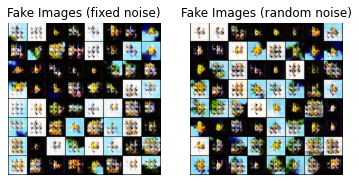

[92/125][0/29]	Loss_D: 0.9499	Loss_G: 1.4711	D(x): 0.4260	D(G(z)): 0.0527 / 0.2422
[92/125][5/29]	Loss_D: 0.5491	Loss_G: 2.7285	D(x): 0.8423	D(G(z)): 0.1718 / 0.0570
[92/125][10/29]	Loss_D: 0.6411	Loss_G: 1.7896	D(x): 0.6602	D(G(z)): 0.1162 / 0.1605
[92/125][15/29]	Loss_D: 0.8584	Loss_G: 3.0276	D(x): 0.8792	D(G(z)): 0.3824 / 0.0408
[92/125][20/29]	Loss_D: 1.4980	Loss_G: 3.2409	D(x): 0.9444	D(G(z)): 0.6607 / 0.0318
[92/125][25/29]	Loss_D: 0.7454	Loss_G: 2.0534	D(x): 0.6481	D(G(z)): 0.1973 / 0.1213


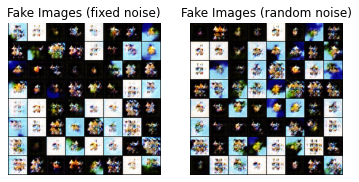

[93/125][0/29]	Loss_D: 0.5627	Loss_G: 3.0871	D(x): 0.7984	D(G(z)): 0.1659 / 0.0370
[93/125][5/29]	Loss_D: 1.1412	Loss_G: 0.5315	D(x): 0.3335	D(G(z)): 0.0480 / 0.6397
[93/125][10/29]	Loss_D: 0.6482	Loss_G: 2.3054	D(x): 0.8304	D(G(z)): 0.2426 / 0.0899
[93/125][15/29]	Loss_D: 0.5871	Loss_G: 3.0688	D(x): 0.8561	D(G(z)): 0.2046 / 0.0387
[93/125][20/29]	Loss_D: 0.8188	Loss_G: 1.9679	D(x): 0.5124	D(G(z)): 0.0452 / 0.1295
[93/125][25/29]	Loss_D: 0.4978	Loss_G: 2.7414	D(x): 0.7725	D(G(z)): 0.0949 / 0.0564


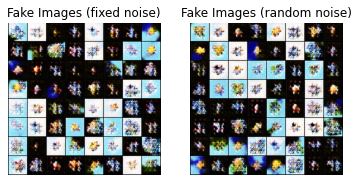

[94/125][0/29]	Loss_D: 0.5281	Loss_G: 2.9944	D(x): 0.8474	D(G(z)): 0.1568 / 0.0422
[94/125][5/29]	Loss_D: 1.2738	Loss_G: 1.2083	D(x): 0.3106	D(G(z)): 0.0276 / 0.3095
[94/125][10/29]	Loss_D: 0.5454	Loss_G: 3.0494	D(x): 0.7063	D(G(z)): 0.0741 / 0.0389
[94/125][15/29]	Loss_D: 0.6021	Loss_G: 2.5601	D(x): 0.8058	D(G(z)): 0.2008 / 0.0656
[94/125][20/29]	Loss_D: 0.8115	Loss_G: 1.4168	D(x): 0.5371	D(G(z)): 0.1162 / 0.2492
[94/125][25/29]	Loss_D: 1.1919	Loss_G: 4.5496	D(x): 0.9118	D(G(z)): 0.5515 / 0.0081


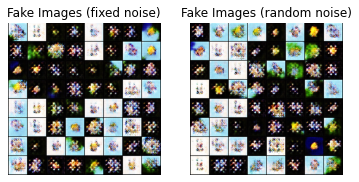

[95/125][0/29]	Loss_D: 0.8305	Loss_G: 2.8535	D(x): 0.8555	D(G(z)): 0.3489 / 0.0583
[95/125][5/29]	Loss_D: 0.7297	Loss_G: 2.9977	D(x): 0.8656	D(G(z)): 0.3013 / 0.0445
[95/125][10/29]	Loss_D: 1.2826	Loss_G: 4.1154	D(x): 0.9225	D(G(z)): 0.5843 / 0.0121
[95/125][15/29]	Loss_D: 0.5032	Loss_G: 2.6772	D(x): 0.8096	D(G(z)): 0.1201 / 0.0611
[95/125][20/29]	Loss_D: 1.1482	Loss_G: 3.7712	D(x): 0.8994	D(G(z)): 0.5282 / 0.0182
[95/125][25/29]	Loss_D: 0.6103	Loss_G: 1.8724	D(x): 0.6463	D(G(z)): 0.0753 / 0.1507


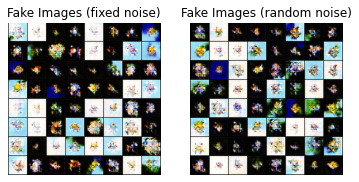

[96/125][0/29]	Loss_D: 0.5401	Loss_G: 2.8799	D(x): 0.7294	D(G(z)): 0.0983 / 0.0494
[96/125][5/29]	Loss_D: 0.8296	Loss_G: 1.6860	D(x): 0.4970	D(G(z)): 0.0743 / 0.1807
[96/125][10/29]	Loss_D: 0.5261	Loss_G: 2.4861	D(x): 0.7482	D(G(z)): 0.0948 / 0.0721
[96/125][15/29]	Loss_D: 1.0846	Loss_G: 4.2387	D(x): 0.9088	D(G(z)): 0.4929 / 0.0106
[96/125][20/29]	Loss_D: 0.8066	Loss_G: 1.2329	D(x): 0.5109	D(G(z)): 0.0707 / 0.2930
[96/125][25/29]	Loss_D: 0.4792	Loss_G: 2.9288	D(x): 0.7617	D(G(z)): 0.0646 / 0.0464


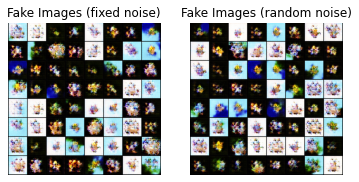

[97/125][0/29]	Loss_D: 0.4960	Loss_G: 2.6956	D(x): 0.8373	D(G(z)): 0.1251 / 0.0592
[97/125][5/29]	Loss_D: 0.5220	Loss_G: 2.4068	D(x): 0.7249	D(G(z)): 0.0692 / 0.0789
[97/125][10/29]	Loss_D: 0.8007	Loss_G: 3.0376	D(x): 0.9200	D(G(z)): 0.3520 / 0.0416
[97/125][15/29]	Loss_D: 0.4337	Loss_G: 3.3177	D(x): 0.8451	D(G(z)): 0.0756 / 0.0292
[97/125][20/29]	Loss_D: 0.5491	Loss_G: 2.5057	D(x): 0.7358	D(G(z)): 0.1064 / 0.0723
[97/125][25/29]	Loss_D: 0.5943	Loss_G: 2.1159	D(x): 0.7231	D(G(z)): 0.1351 / 0.1121


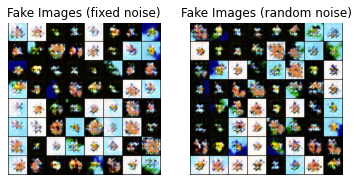

[98/125][0/29]	Loss_D: 0.7232	Loss_G: 4.0837	D(x): 0.7759	D(G(z)): 0.2682 / 0.0130
[98/125][5/29]	Loss_D: 1.8507	Loss_G: 0.4506	D(x): 0.1598	D(G(z)): 0.0094 / 0.7229
[98/125][10/29]	Loss_D: 0.6479	Loss_G: 2.3437	D(x): 0.6296	D(G(z)): 0.0785 / 0.0919
[98/125][15/29]	Loss_D: 0.5723	Loss_G: 2.1370	D(x): 0.7170	D(G(z)): 0.1124 / 0.1100
[98/125][20/29]	Loss_D: 0.5978	Loss_G: 1.6965	D(x): 0.6476	D(G(z)): 0.0604 / 0.1921
[98/125][25/29]	Loss_D: 1.1538	Loss_G: 3.7769	D(x): 0.9653	D(G(z)): 0.5074 / 0.0181


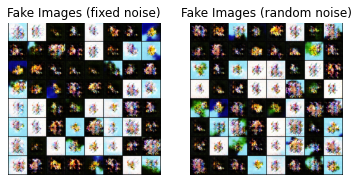

[99/125][0/29]	Loss_D: 0.5473	Loss_G: 2.5634	D(x): 0.7121	D(G(z)): 0.0790 / 0.0661
[99/125][5/29]	Loss_D: 0.5561	Loss_G: 2.1397	D(x): 0.7129	D(G(z)): 0.0991 / 0.1054
[99/125][10/29]	Loss_D: 1.6100	Loss_G: 1.0313	D(x): 0.2308	D(G(z)): 0.0195 / 0.3528
[99/125][15/29]	Loss_D: 0.6009	Loss_G: 2.6967	D(x): 0.6236	D(G(z)): 0.0452 / 0.0635
[99/125][20/29]	Loss_D: 0.5219	Loss_G: 3.2000	D(x): 0.7017	D(G(z)): 0.0478 / 0.0396
[99/125][25/29]	Loss_D: 0.7969	Loss_G: 2.7119	D(x): 0.7118	D(G(z)): 0.2825 / 0.0569


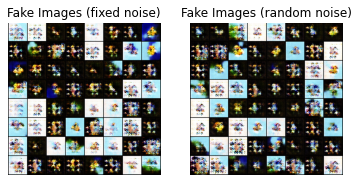

[100/125][0/29]	Loss_D: 0.5185	Loss_G: 3.4171	D(x): 0.8357	D(G(z)): 0.1429 / 0.0278
[100/125][5/29]	Loss_D: 0.7001	Loss_G: 1.3469	D(x): 0.6067	D(G(z)): 0.1121 / 0.2911
[100/125][10/29]	Loss_D: 0.6514	Loss_G: 1.6425	D(x): 0.5955	D(G(z)): 0.0423 / 0.2040
[100/125][15/29]	Loss_D: 0.7214	Loss_G: 1.2783	D(x): 0.5441	D(G(z)): 0.0429 / 0.3080
[100/125][20/29]	Loss_D: 0.4440	Loss_G: 2.6863	D(x): 0.8087	D(G(z)): 0.0644 / 0.0655
[100/125][25/29]	Loss_D: 0.5791	Loss_G: 2.6768	D(x): 0.6394	D(G(z)): 0.0350 / 0.0658


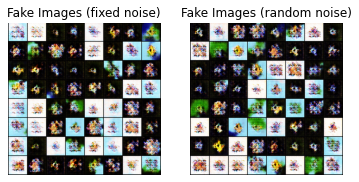

[101/125][0/29]	Loss_D: 0.5211	Loss_G: 2.4818	D(x): 0.7990	D(G(z)): 0.1247 / 0.0766
[101/125][5/29]	Loss_D: 0.5878	Loss_G: 3.1557	D(x): 0.8177	D(G(z)): 0.1843 / 0.0405
[101/125][10/29]	Loss_D: 1.3640	Loss_G: 1.0143	D(x): 0.3392	D(G(z)): 0.0535 / 0.3866
[101/125][15/29]	Loss_D: 0.6113	Loss_G: 2.1204	D(x): 0.6418	D(G(z)): 0.0679 / 0.1281
[101/125][20/29]	Loss_D: 0.8746	Loss_G: 2.6040	D(x): 0.4696	D(G(z)): 0.0202 / 0.0649
[101/125][25/29]	Loss_D: 0.9607	Loss_G: 3.8293	D(x): 0.8549	D(G(z)): 0.4373 / 0.0206


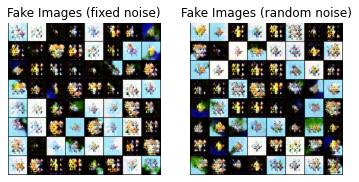

[102/125][0/29]	Loss_D: 1.0990	Loss_G: 1.3166	D(x): 0.3705	D(G(z)): 0.0440 / 0.2803
[102/125][5/29]	Loss_D: 0.6283	Loss_G: 1.9894	D(x): 0.5858	D(G(z)): 0.0249 / 0.1330
[102/125][10/29]	Loss_D: 0.8122	Loss_G: 1.7014	D(x): 0.5068	D(G(z)): 0.0713 / 0.1835
[102/125][15/29]	Loss_D: 0.6131	Loss_G: 2.5238	D(x): 0.6965	D(G(z)): 0.1216 / 0.0805
[102/125][20/29]	Loss_D: 0.5340	Loss_G: 2.8531	D(x): 0.7054	D(G(z)): 0.0674 / 0.0542
[102/125][25/29]	Loss_D: 0.5481	Loss_G: 3.0166	D(x): 0.8571	D(G(z)): 0.1701 / 0.0403


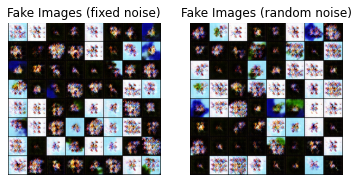

[103/125][0/29]	Loss_D: 0.5885	Loss_G: 3.3242	D(x): 0.8323	D(G(z)): 0.1907 / 0.0291
[103/125][5/29]	Loss_D: 0.6758	Loss_G: 3.2350	D(x): 0.7868	D(G(z)): 0.2337 / 0.0338
[103/125][10/29]	Loss_D: 0.8762	Loss_G: 3.4524	D(x): 0.7954	D(G(z)): 0.3619 / 0.0257
[103/125][15/29]	Loss_D: 0.8604	Loss_G: 1.6342	D(x): 0.4648	D(G(z)): 0.0340 / 0.1989
[103/125][20/29]	Loss_D: 0.6547	Loss_G: 2.6007	D(x): 0.8237	D(G(z)): 0.2368 / 0.0678
[103/125][25/29]	Loss_D: 1.2498	Loss_G: 1.1644	D(x): 0.3184	D(G(z)): 0.0348 / 0.3270


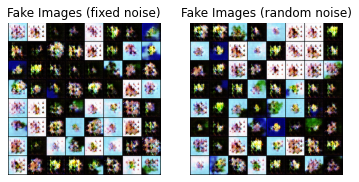

[104/125][0/29]	Loss_D: 0.9746	Loss_G: 2.6607	D(x): 0.5938	D(G(z)): 0.1862 / 0.0723
[104/125][5/29]	Loss_D: 1.1724	Loss_G: 4.1427	D(x): 0.8930	D(G(z)): 0.5093 / 0.0138
[104/125][10/29]	Loss_D: 0.6757	Loss_G: 2.4039	D(x): 0.6769	D(G(z)): 0.1563 / 0.0832
[104/125][15/29]	Loss_D: 0.4552	Loss_G: 3.7433	D(x): 0.8177	D(G(z)): 0.0776 / 0.0194
[104/125][20/29]	Loss_D: 0.5488	Loss_G: 3.0287	D(x): 0.7989	D(G(z)): 0.1465 / 0.0436
[104/125][25/29]	Loss_D: 0.6836	Loss_G: 3.5944	D(x): 0.8583	D(G(z)): 0.2774 / 0.0216


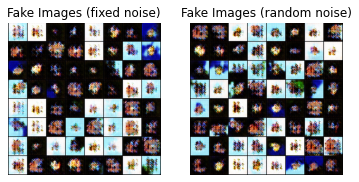

[105/125][0/29]	Loss_D: 0.4677	Loss_G: 2.6621	D(x): 0.7805	D(G(z)): 0.0704 / 0.0640
[105/125][5/29]	Loss_D: 0.6853	Loss_G: 2.9350	D(x): 0.7487	D(G(z)): 0.2231 / 0.0488
[105/125][10/29]	Loss_D: 0.6331	Loss_G: 2.2094	D(x): 0.6530	D(G(z)): 0.0995 / 0.1000
[105/125][15/29]	Loss_D: 1.3061	Loss_G: 5.9266	D(x): 0.9523	D(G(z)): 0.5720 / 0.0020
[105/125][20/29]	Loss_D: 0.5107	Loss_G: 3.7351	D(x): 0.8585	D(G(z)): 0.1321 / 0.0231
[105/125][25/29]	Loss_D: 0.6326	Loss_G: 3.3602	D(x): 0.8233	D(G(z)): 0.2217 / 0.0295


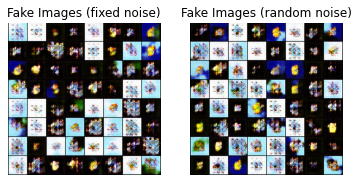

[106/125][0/29]	Loss_D: 0.5919	Loss_G: 2.4183	D(x): 0.7766	D(G(z)): 0.1694 / 0.0906
[106/125][5/29]	Loss_D: 0.5182	Loss_G: 2.4983	D(x): 0.8227	D(G(z)): 0.1372 / 0.0729
[106/125][10/29]	Loss_D: 0.5539	Loss_G: 2.9136	D(x): 0.8666	D(G(z)): 0.1831 / 0.0458
[106/125][15/29]	Loss_D: 0.5482	Loss_G: 2.6372	D(x): 0.7540	D(G(z)): 0.1152 / 0.0659
[106/125][20/29]	Loss_D: 0.5251	Loss_G: 3.1724	D(x): 0.8074	D(G(z)): 0.1341 / 0.0338
[106/125][25/29]	Loss_D: 0.4899	Loss_G: 2.6725	D(x): 0.7483	D(G(z)): 0.0588 / 0.0600


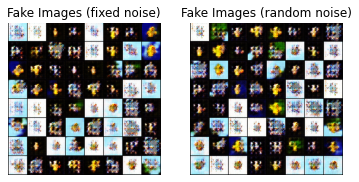

[107/125][0/29]	Loss_D: 0.7225	Loss_G: 1.2989	D(x): 0.5503	D(G(z)): 0.0385 / 0.2821
[107/125][5/29]	Loss_D: 2.8414	Loss_G: 2.4006	D(x): 0.9862	D(G(z)): 0.8850 / 0.0783
[107/125][10/29]	Loss_D: 0.6096	Loss_G: 2.4529	D(x): 0.7045	D(G(z)): 0.1354 / 0.0813
[107/125][15/29]	Loss_D: 0.6541	Loss_G: 2.8221	D(x): 0.8807	D(G(z)): 0.2598 / 0.0497
[107/125][20/29]	Loss_D: 0.5713	Loss_G: 2.5550	D(x): 0.7276	D(G(z)): 0.1180 / 0.0697
[107/125][25/29]	Loss_D: 0.7720	Loss_G: 0.8630	D(x): 0.5160	D(G(z)): 0.0501 / 0.4508


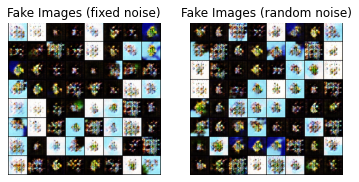

[108/125][0/29]	Loss_D: 0.5412	Loss_G: 3.4778	D(x): 0.7443	D(G(z)): 0.1010 / 0.0271
[108/125][5/29]	Loss_D: 0.5055	Loss_G: 3.4233	D(x): 0.8494	D(G(z)): 0.1376 / 0.0269
[108/125][10/29]	Loss_D: 0.5422	Loss_G: 3.1262	D(x): 0.7485	D(G(z)): 0.1149 / 0.0388
[108/125][15/29]	Loss_D: 0.6963	Loss_G: 3.8936	D(x): 0.8745	D(G(z)): 0.2901 / 0.0149
[108/125][20/29]	Loss_D: 0.5534	Loss_G: 3.4739	D(x): 0.9144	D(G(z)): 0.1781 / 0.0258
[108/125][25/29]	Loss_D: 0.6564	Loss_G: 3.4897	D(x): 0.7965	D(G(z)): 0.2243 / 0.0260


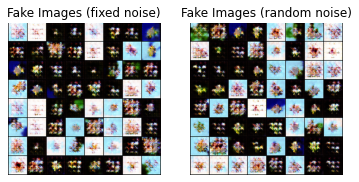

[109/125][0/29]	Loss_D: 0.5619	Loss_G: 2.1064	D(x): 0.6767	D(G(z)): 0.0627 / 0.1163
[109/125][5/29]	Loss_D: 0.5901	Loss_G: 3.5888	D(x): 0.8535	D(G(z)): 0.1912 / 0.0229
[109/125][10/29]	Loss_D: 1.6592	Loss_G: 6.9829	D(x): 0.9434	D(G(z)): 0.6965 / 0.0006
[109/125][15/29]	Loss_D: 0.6387	Loss_G: 3.5527	D(x): 0.9025	D(G(z)): 0.2435 / 0.0243
[109/125][20/29]	Loss_D: 0.9343	Loss_G: 4.7071	D(x): 0.8144	D(G(z)): 0.3955 / 0.0066
[109/125][25/29]	Loss_D: 0.6651	Loss_G: 2.7595	D(x): 0.8438	D(G(z)): 0.2592 / 0.0585


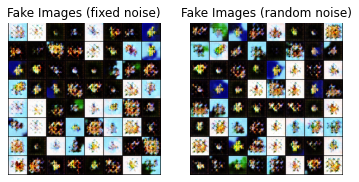

[110/125][0/29]	Loss_D: 0.5126	Loss_G: 2.5305	D(x): 0.8492	D(G(z)): 0.1436 / 0.0718
[110/125][5/29]	Loss_D: 0.5679	Loss_G: 2.2598	D(x): 0.6703	D(G(z)): 0.0670 / 0.0931
[110/125][10/29]	Loss_D: 0.5019	Loss_G: 2.5222	D(x): 0.7263	D(G(z)): 0.0533 / 0.0717
[110/125][15/29]	Loss_D: 0.4830	Loss_G: 3.1610	D(x): 0.8258	D(G(z)): 0.1040 / 0.0345
[110/125][20/29]	Loss_D: 0.4754	Loss_G: 2.8896	D(x): 0.7902	D(G(z)): 0.0840 / 0.0475
[110/125][25/29]	Loss_D: 0.5008	Loss_G: 3.2154	D(x): 0.8085	D(G(z)): 0.1158 / 0.0329


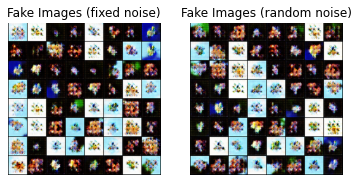

[111/125][0/29]	Loss_D: 0.8126	Loss_G: 3.9451	D(x): 0.9320	D(G(z)): 0.3411 / 0.0179
[111/125][5/29]	Loss_D: 0.6191	Loss_G: 3.1743	D(x): 0.6247	D(G(z)): 0.0574 / 0.0384
[111/125][10/29]	Loss_D: 0.5478	Loss_G: 2.7974	D(x): 0.7881	D(G(z)): 0.1357 / 0.0552
[111/125][15/29]	Loss_D: 0.8724	Loss_G: 3.6044	D(x): 0.9085	D(G(z)): 0.3850 / 0.0213
[111/125][20/29]	Loss_D: 0.7794	Loss_G: 3.8157	D(x): 0.9412	D(G(z)): 0.3302 / 0.0188
[111/125][25/29]	Loss_D: 0.5024	Loss_G: 2.7883	D(x): 0.8526	D(G(z)): 0.1364 / 0.0502


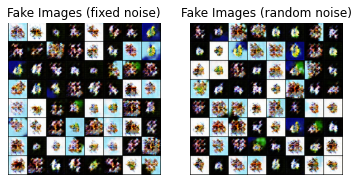

[112/125][0/29]	Loss_D: 0.6114	Loss_G: 2.5797	D(x): 0.7331	D(G(z)): 0.1489 / 0.0689
[112/125][5/29]	Loss_D: 1.0239	Loss_G: 3.9858	D(x): 0.9253	D(G(z)): 0.4428 / 0.0150
[112/125][10/29]	Loss_D: 0.4591	Loss_G: 2.8140	D(x): 0.8000	D(G(z)): 0.0711 / 0.0552
[112/125][15/29]	Loss_D: 0.6094	Loss_G: 3.4334	D(x): 0.7901	D(G(z)): 0.1844 / 0.0265
[112/125][20/29]	Loss_D: 0.5605	Loss_G: 2.6082	D(x): 0.6711	D(G(z)): 0.0471 / 0.0679
[112/125][25/29]	Loss_D: 0.5327	Loss_G: 3.0640	D(x): 0.7709	D(G(z)): 0.1185 / 0.0405


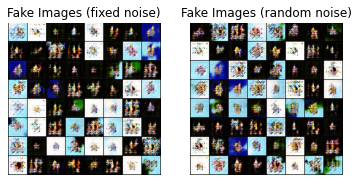

[113/125][0/29]	Loss_D: 1.5300	Loss_G: 5.4584	D(x): 0.9528	D(G(z)): 0.6540 / 0.0068
[113/125][5/29]	Loss_D: 0.5709	Loss_G: 1.9716	D(x): 0.7455	D(G(z)): 0.1232 / 0.1358
[113/125][10/29]	Loss_D: 0.5158	Loss_G: 2.8052	D(x): 0.8741	D(G(z)): 0.1501 / 0.0601
[113/125][15/29]	Loss_D: 0.5178	Loss_G: 2.2864	D(x): 0.7437	D(G(z)): 0.0802 / 0.0920
[113/125][20/29]	Loss_D: 0.6395	Loss_G: 1.9111	D(x): 0.6292	D(G(z)): 0.0819 / 0.1606
[113/125][25/29]	Loss_D: 0.6084	Loss_G: 2.5616	D(x): 0.8691	D(G(z)): 0.2114 / 0.0790


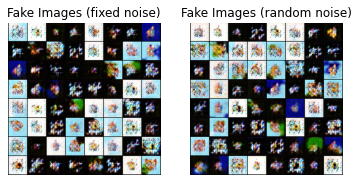

[114/125][0/29]	Loss_D: 0.8586	Loss_G: 1.9995	D(x): 0.4937	D(G(z)): 0.0384 / 0.1353
[114/125][5/29]	Loss_D: 0.5141	Loss_G: 2.8249	D(x): 0.7514	D(G(z)): 0.0888 / 0.0528
[114/125][10/29]	Loss_D: 0.8021	Loss_G: 1.7667	D(x): 0.5206	D(G(z)): 0.0816 / 0.1611
[114/125][15/29]	Loss_D: 0.6123	Loss_G: 2.1737	D(x): 0.6247	D(G(z)): 0.0459 / 0.1312
[114/125][20/29]	Loss_D: 0.5941	Loss_G: 1.9467	D(x): 0.6629	D(G(z)): 0.0749 / 0.1404
[114/125][25/29]	Loss_D: 0.5095	Loss_G: 3.3779	D(x): 0.8357	D(G(z)): 0.1297 / 0.0286


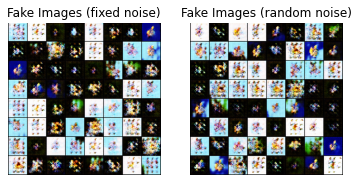

[115/125][0/29]	Loss_D: 0.4841	Loss_G: 2.5822	D(x): 0.7787	D(G(z)): 0.0791 / 0.0718
[115/125][5/29]	Loss_D: 0.5520	Loss_G: 2.2579	D(x): 0.6756	D(G(z)): 0.0564 / 0.1038
[115/125][10/29]	Loss_D: 0.4621	Loss_G: 2.6116	D(x): 0.7801	D(G(z)): 0.0561 / 0.0675
[115/125][15/29]	Loss_D: 0.9526	Loss_G: 4.0532	D(x): 0.9574	D(G(z)): 0.4029 / 0.0154
[115/125][20/29]	Loss_D: 0.8903	Loss_G: 3.9947	D(x): 0.9570	D(G(z)): 0.3689 / 0.0243
[115/125][25/29]	Loss_D: 0.5156	Loss_G: 2.6072	D(x): 0.7750	D(G(z)): 0.0962 / 0.0666


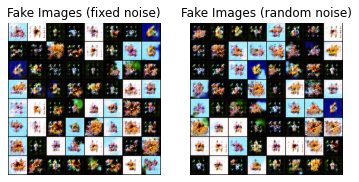

[116/125][0/29]	Loss_D: 1.0528	Loss_G: 0.9710	D(x): 0.3890	D(G(z)): 0.0336 / 0.4194
[116/125][5/29]	Loss_D: 0.4828	Loss_G: 2.2899	D(x): 0.7950	D(G(z)): 0.0892 / 0.0968
[116/125][10/29]	Loss_D: 0.5269	Loss_G: 3.2169	D(x): 0.8932	D(G(z)): 0.1594 / 0.0347
[116/125][15/29]	Loss_D: 0.5358	Loss_G: 3.1713	D(x): 0.7019	D(G(z)): 0.0451 / 0.0414
[116/125][20/29]	Loss_D: 0.5433	Loss_G: 3.5110	D(x): 0.8502	D(G(z)): 0.1586 / 0.0243
[116/125][25/29]	Loss_D: 0.5914	Loss_G: 3.9805	D(x): 0.9244	D(G(z)): 0.2024 / 0.0166


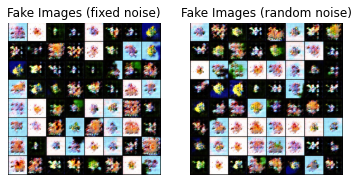

[117/125][0/29]	Loss_D: 0.5741	Loss_G: 2.7177	D(x): 0.7643	D(G(z)): 0.1435 / 0.0580
[117/125][5/29]	Loss_D: 0.9751	Loss_G: 0.9146	D(x): 0.4131	D(G(z)): 0.0253 / 0.4926
[117/125][10/29]	Loss_D: 0.5375	Loss_G: 2.7569	D(x): 0.8234	D(G(z)): 0.1413 / 0.0673
[117/125][15/29]	Loss_D: 0.7698	Loss_G: 1.6015	D(x): 0.5343	D(G(z)): 0.0424 / 0.2457
[117/125][20/29]	Loss_D: 0.5718	Loss_G: 1.8342	D(x): 0.6682	D(G(z)): 0.0525 / 0.1619
[117/125][25/29]	Loss_D: 0.7877	Loss_G: 1.9628	D(x): 0.5058	D(G(z)): 0.0261 / 0.1410


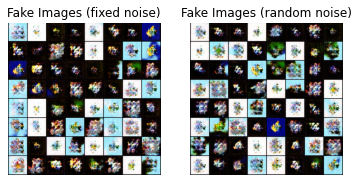

[118/125][0/29]	Loss_D: 0.5326	Loss_G: 2.6362	D(x): 0.7312	D(G(z)): 0.0783 / 0.0631
[118/125][5/29]	Loss_D: 0.6955	Loss_G: 3.8374	D(x): 0.8534	D(G(z)): 0.2836 / 0.0167
[118/125][10/29]	Loss_D: 0.4839	Loss_G: 3.4770	D(x): 0.8625	D(G(z)): 0.1185 / 0.0251
[118/125][15/29]	Loss_D: 0.8301	Loss_G: 5.0745	D(x): 0.8922	D(G(z)): 0.3587 / 0.0051
[118/125][20/29]	Loss_D: 1.3958	Loss_G: 1.5232	D(x): 0.2684	D(G(z)): 0.0137 / 0.2304
[118/125][25/29]	Loss_D: 0.5181	Loss_G: 3.9184	D(x): 0.8338	D(G(z)): 0.1316 / 0.0175


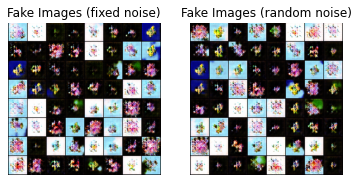

[119/125][0/29]	Loss_D: 0.5753	Loss_G: 2.0351	D(x): 0.6550	D(G(z)): 0.0470 / 0.1258
[119/125][5/29]	Loss_D: 0.5476	Loss_G: 2.9595	D(x): 0.8312	D(G(z)): 0.1505 / 0.0480
[119/125][10/29]	Loss_D: 0.5151	Loss_G: 2.5748	D(x): 0.7931	D(G(z)): 0.1051 / 0.0703
[119/125][15/29]	Loss_D: 0.6071	Loss_G: 1.6395	D(x): 0.6585	D(G(z)): 0.0874 / 0.1949
[119/125][20/29]	Loss_D: 0.5308	Loss_G: 2.3309	D(x): 0.7453	D(G(z)): 0.0920 / 0.0956
[119/125][25/29]	Loss_D: 0.6814	Loss_G: 3.2252	D(x): 0.8188	D(G(z)): 0.2419 / 0.0392


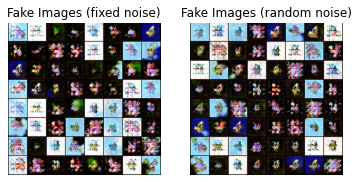

[120/125][0/29]	Loss_D: 0.6530	Loss_G: 3.9659	D(x): 0.9164	D(G(z)): 0.2492 / 0.0151
[120/125][5/29]	Loss_D: 0.4730	Loss_G: 3.3673	D(x): 0.8783	D(G(z)): 0.1137 / 0.0298
[120/125][10/29]	Loss_D: 0.4685	Loss_G: 3.0008	D(x): 0.8025	D(G(z)): 0.0817 / 0.0433
[120/125][15/29]	Loss_D: 1.3701	Loss_G: 4.8173	D(x): 0.9750	D(G(z)): 0.5776 / 0.0059
[120/125][20/29]	Loss_D: 0.5437	Loss_G: 3.4726	D(x): 0.7976	D(G(z)): 0.1333 / 0.0283
[120/125][25/29]	Loss_D: 0.6264	Loss_G: 3.2412	D(x): 0.6212	D(G(z)): 0.0600 / 0.0365


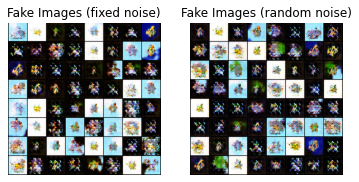

[121/125][0/29]	Loss_D: 0.4963	Loss_G: 2.5417	D(x): 0.7610	D(G(z)): 0.0762 / 0.0728
[121/125][5/29]	Loss_D: 0.6183	Loss_G: 2.9015	D(x): 0.6353	D(G(z)): 0.0496 / 0.0549
[121/125][10/29]	Loss_D: 0.5134	Loss_G: 2.6742	D(x): 0.7744	D(G(z)): 0.0999 / 0.0596
[121/125][15/29]	Loss_D: 0.5435	Loss_G: 3.0958	D(x): 0.6698	D(G(z)): 0.0366 / 0.0428
[121/125][20/29]	Loss_D: 0.7812	Loss_G: 1.3891	D(x): 0.6032	D(G(z)): 0.1720 / 0.2431
[121/125][25/29]	Loss_D: 0.5444	Loss_G: 2.7195	D(x): 0.7995	D(G(z)): 0.1475 / 0.0597


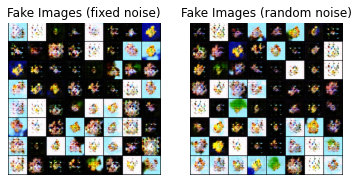

[122/125][0/29]	Loss_D: 0.6221	Loss_G: 2.1858	D(x): 0.6527	D(G(z)): 0.0803 / 0.1216
[122/125][5/29]	Loss_D: 0.5433	Loss_G: 2.5115	D(x): 0.6978	D(G(z)): 0.0659 / 0.0746
[122/125][10/29]	Loss_D: 0.5316	Loss_G: 3.3607	D(x): 0.8471	D(G(z)): 0.1557 / 0.0310
[122/125][15/29]	Loss_D: 0.5711	Loss_G: 2.2452	D(x): 0.7047	D(G(z)): 0.1010 / 0.0922
[122/125][20/29]	Loss_D: 0.4842	Loss_G: 2.7723	D(x): 0.7626	D(G(z)): 0.0579 / 0.0590
[122/125][25/29]	Loss_D: 1.4569	Loss_G: 4.4304	D(x): 0.9289	D(G(z)): 0.5484 / 0.0091


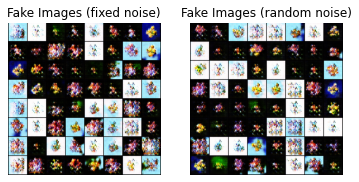

[123/125][0/29]	Loss_D: 0.7484	Loss_G: 3.4662	D(x): 0.9045	D(G(z)): 0.3076 / 0.0304
[123/125][5/29]	Loss_D: 0.6704	Loss_G: 4.1727	D(x): 0.8474	D(G(z)): 0.2567 / 0.0123
[123/125][10/29]	Loss_D: 0.6630	Loss_G: 2.2055	D(x): 0.6516	D(G(z)): 0.1178 / 0.1090
[123/125][15/29]	Loss_D: 0.5058	Loss_G: 2.5529	D(x): 0.8659	D(G(z)): 0.1419 / 0.0682
[123/125][20/29]	Loss_D: 0.7290	Loss_G: 0.7993	D(x): 0.5577	D(G(z)): 0.0689 / 0.4649
[123/125][25/29]	Loss_D: 0.6116	Loss_G: 1.7379	D(x): 0.6359	D(G(z)): 0.0640 / 0.1686


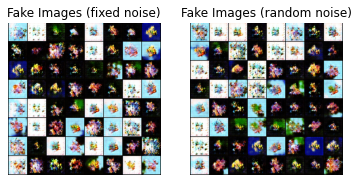

[124/125][0/29]	Loss_D: 0.5162	Loss_G: 3.0487	D(x): 0.8008	D(G(z)): 0.1188 / 0.0407
[124/125][5/29]	Loss_D: 0.5576	Loss_G: 2.1832	D(x): 0.7456	D(G(z)): 0.1149 / 0.1025
[124/125][10/29]	Loss_D: 0.6881	Loss_G: 3.3466	D(x): 0.9216	D(G(z)): 0.2758 / 0.0282
[124/125][15/29]	Loss_D: 0.7745	Loss_G: 3.9968	D(x): 0.9411	D(G(z)): 0.3304 / 0.0145
[124/125][20/29]	Loss_D: 0.6474	Loss_G: 4.0213	D(x): 0.9209	D(G(z)): 0.2458 / 0.0145
[124/125][25/29]	Loss_D: 0.5988	Loss_G: 1.2375	D(x): 0.6407	D(G(z)): 0.0665 / 0.3107


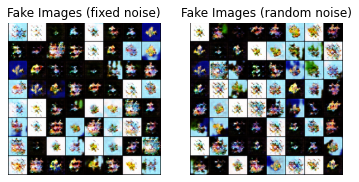

[125/125][0/29]	Loss_D: 0.4846	Loss_G: 3.3940	D(x): 0.8423	D(G(z)): 0.1116 / 0.0316
[125/125][5/29]	Loss_D: 0.5654	Loss_G: 2.7709	D(x): 0.7165	D(G(z)): 0.1020 / 0.0633
[125/125][10/29]	Loss_D: 0.5972	Loss_G: 3.8804	D(x): 0.8470	D(G(z)): 0.1997 / 0.0182
[125/125][15/29]	Loss_D: 0.7675	Loss_G: 1.8129	D(x): 0.4996	D(G(z)): 0.0241 / 0.2033
[125/125][20/29]	Loss_D: 0.4956	Loss_G: 2.3311	D(x): 0.7301	D(G(z)): 0.0555 / 0.0976
[125/125][25/29]	Loss_D: 0.5728	Loss_G: 2.4883	D(x): 0.7449	D(G(z)): 0.1288 / 0.0759


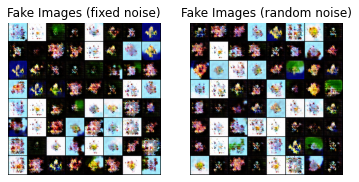

In [ ]:
# Main training loop

# To keep track of progress
img_list = []
img_list_rand = []
G_losses = []
D_losses = []
iters = 0

print("Consider making a cup of coffee in the meantime")
for epoch in range(n_epochs):
  for batch_i, real_imgs in enumerate(dataloader, 0):
    #print('Iteration n°%d' % (batch_i+1))
    # zeroing gradients at each loop
    netD.zero_grad()
    netG.zero_grad()

    # This loop's images:
    real_imgs = real_imgs[0].to(device) # retrieving real imgs
    #real_imgs = change_bg_to_black(real_imgs[0]).to(device)

    noise = torch.randn(batch_size, noise_dim, 1, 1, device=device)
    fake_imgs = netG(noise) # generating fake ones

    # Creating label tensors to compute loss
    label_r = torch.full((batch_size,), label_real, dtype=torch.float, device=device)
    # full of 0.9's
    label_f = torch.full((batch_size,), label_fake, dtype=torch.float, device=device)
    # full of 0's


    ############################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ############################

    #### (1.1) Training on real images
    # Forward pass
    # score on batch of real imgs
    outputR = netD(real_imgs).view(-1) # flattens the matrix
    lossD_real = loss_func(outputR,label_r)
    # Backward pass to get gradients
    lossD_real.backward()

    #### (1.2) Training on fake images
    # Forward pass
    outputF = netD(fake_imgs.detach()).view(-1)
    lossD_fake = loss_func(outputF,label_f)
    # Backward pass to get gradients
    lossD_fake.backward()

    # Optimization step
    optD.step()


    ############################
    # (2) Update G network: maximize D(G(z))
    ############################

    # We've already generated the fake images and scored them
    # But D has been updated -> get them scored again to obtain D(G(z))
    output = netD(fake_imgs).view(-1)
    # no use generating new fake imgs, G hasn't been updated yet
    lossG = loss_func(output,label_r) # To G, its images count as real ones
    # so we use label_real
    lossG.backward()

    # Optimization step
    optG.step()


    ###########################
    # This section is to keep track of progress, irrelevant to actual workings
    ###########################
    lossD = lossD_fake + lossD_real
    D_x = outputR.mean() # D(x)
    D_G_z1 = outputF.mean() # D(G(z)) before update of Discriminator
    D_G_z2 = output.mean() # D(G(z)) after update of Discriminator

    if batch_i % 5 == 0:
        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
              % (epoch+1, n_epochs, batch_i, len(dataloader),
                  lossD.item(), lossG.item(), D_x, D_G_z1, D_G_z2))

    # Save Losses for plotting later
    G_losses.append(lossG.item())
    D_losses.append(lossD.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % len(dataloader) == 0) or ((epoch == n_epochs-1) and (batch_i == len(dataloader)-1)):
        rand_noise = torch.randn(64, noise_dim, 1, 1, device=device)
        with torch.no_grad():
            fake = netG(fixed_noise).detach().cpu()
            fake_rand = netG(rand_noise).detach().cpu()
        img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        img_list_rand.append(vutils.make_grid(fake_rand, padding=2, normalize=True))

    iters += 1

  # Plot the fake images from fixed noise after every epoch to see how output
  # changes
  plt.subplot(1,2,1)
  plt.axis("off")
  plt.title("Fake Images (fixed noise)")
  plt.imshow(np.transpose(img_list[-1],(1,2,0)))

  # Plot fake images from randomised noise at each epoch
  plt.subplot(1,2,2)
  plt.axis("off")
  plt.title("Fake Images (random noise)")
  plt.imshow(np.transpose(img_list_rand[-1],(1,2,0)))

  plt.show()

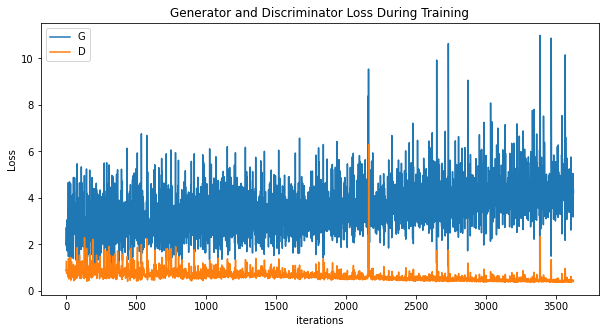

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

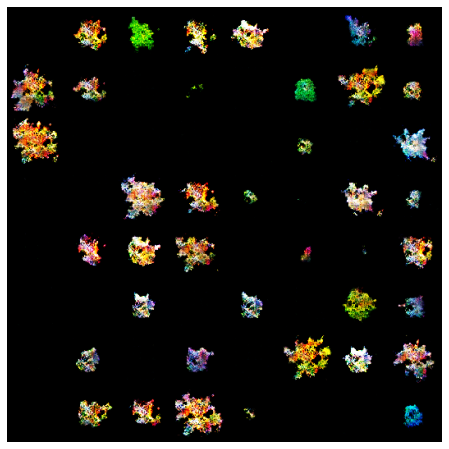

In [ ]:
# Transofrms saved images of the fixed noise into GIF so we may see
# the evolution of the generator's output
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[len(img_list)//2:]] # choose index at will
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

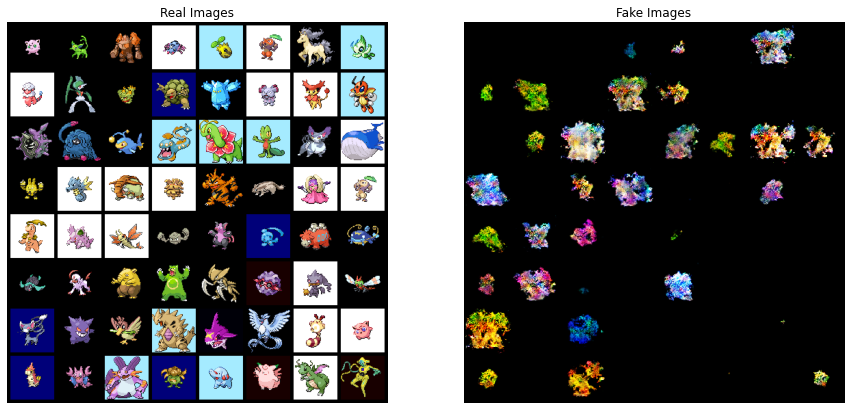

In [ ]:
# Plotting the images

# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[98],(1,2,0))) # change index at will
plt.show()